<a href="https://www.bigdatauniversity.com/?utm_medium=Exinfluencer&utm_source=Exinfluencer&utm_content=000026UJ&utm_term=10006555&utm_id=NA-SkillsNetwork-Channel-SkillsNetworkCoursesIBMDeveloperSkillsNetworkML0101ESedX20816812-2022-01-01"><img src="https://ibm.box.com/shared/static/cw2c7r3o20w9zn8gkecaeyjhgw3xdgbj.png" width="400" align="center"></a>

<h1 align="center"><font size="5">Proyecto Final Coursera Capstone Mejora de la Seguridad Vial en Bucaramanga a través del Análisis de Accidentes de Tránsito en la Ciudad de bucaramanga, Colombia</font></h1>

<center><div class="alert alert-block alert-info">
    <strong>Oscar Augusto Diaz Triana</strong><br>
    <strong>Ciencia de Datos Aplicada</strong>
</div></center>

## Tabla de contenidos
* [Introducción: Problema de negocio](#introduction)
* [Datos](#data)
* [Metodología](#methodology)
* [Análisis](#analysis)
* [Resultados y Discusión](#results)
* [Conclusión](#conclusion)

# Introducción <a name="introduction"></a>

En la actualidad, los accidentes de tránsito representan una preocupación constante en las ciudades de todo el mundo. Bucaramanga, una ciudad en Colombia, no es una excepción. La seguridad vial es un tema crucial que afecta no solo a los conductores y peatones, sino también a la infraestructura urbana, los servicios de emergencia y la calidad de vida en general. Con el aumento del tráfico, la diversidad de vehículos en las carreteras y la interacción entre diferentes modos de transporte, la identificación de patrones y factores relacionados con los accidentes de tránsito se ha convertido en una prioridad para las autoridades y la comunidad en Bucaramanga.

## El Problema

El objetivo principal de este proyecto es analizar y comprender los patrones de accidentes de tránsito en la ciudad de Bucaramanga. Para lograrlo, se utilizará un conjunto de datos que registra la ubicación de accidentes de tránsito en la ciudad. El análisis de estos datos permitirá identificar áreas problemáticas, factores de riesgo y tendencias que contribuyen a la ocurrencia de accidentes. Además, se buscará desarrollar recomendaciones y estrategias para mejorar la seguridad vial y reducir la frecuencia y gravedad de los accidentes.

# Datos <a name="data"></a>

El conjunto de datos utilizado en este proyecto contiene información detallada sobre los accidentes de tránsito en Bucaramanga. Cada registro incluye datos como la ubicación geográfica (latitud y longitud), la fecha y hora del accidente, las condiciones climáticas, el tipo de vehículos involucrados, la causa probable del accidente y otros detalles relevantes. Estos datos proporcionarán una visión holística de los accidentes en la ciudad y permitirán un análisis profundo de los factores subyacentes.

Los datos fueron adquirodos desde la plataforma del gobierno Colombiano, denominada Datos Abiertos https://datos.gov.co/, espefificamente en esta dirección, https://www.datos.gov.co/Transporte/03-ACCIDENTES-DE-TRANSITO-DESDE-ENERO-2012-A-FEBRE/7cci-nqqb

Los datos que se utilizarán para resolver el problema de los accidentes de tránsito en Bucaramanga provienen de un conjunto de datos que registra información detallada sobre los accidentes. A continuación, se describen las variables presentes en el conjunto de datos:

1. **ORDEN**: Un identificador único para cada registro de accidente.
2. **FECHA**: La fecha en que ocurrió el accidente.
3. **AÑO**: El año en que ocurrió el accidente.
4. **MES**: El mes en que ocurrió el accidente.
5. **DÍA**: El día de la semana en que ocurrió el accidente.
6. **GRAVEDAD**: Indica la gravedad del accidente (Con Heridos, Solo Daños, etc.).
7. **PEATON**: Número de peatones involucrados en el accidente.
8. **AUTOMOVIL, CAMPAERO, CAMIONETA, MICRO, BUSETA, BUS, CAMION, VOLQUETA, MOTO, BICICLETA, OTRO**: Números de diferentes tipos de vehículos involucrados en el accidente.
9. **VIA 1**: La vía principal donde ocurrió el accidente.
10. **BARRIO**: El barrio o ubicación donde ocurrió el accidente.
11. **HORA**: La hora del día en que ocurrió el accidente.
12. **ENTIDAD**: La entidad que atendió el accidente.
13. **nombrecomuna**: El nombre de la comuna en la que ocurrió el accidente.
14. **Propietario de Vehículo**: Propietario del vehículo involucrado.
15. **DIURNIO/NOCTURNO**: Indica si el accidente ocurrió durante el día o la noche.
16. **HORA RESTRICCION MOTO**: Información sobre la restricción de motocicletas.

Este conjunto de datos proporciona información valiosa sobre las características de los accidentes, incluyendo la ubicación geográfica, la gravedad, los tipos de vehículos involucrados y la hora del día en que ocurren. Además de estos datos, se utilizarán los datos de ubicación de Foursquare para enriquecer el análisis. Los datos de Foursquare pueden incluir información sobre la densidad de tráfico, la presencia de infraestructura vial (señales, semáforos, pasos de peatones, etc.) y la ubicación de establecimientos como hospitales y estaciones de policía, que podrían ser relevantes para el análisis de accidentes de tránsito.

La combinación de estos datos permitirá realizar un análisis más completo y profundo de los accidentes de tránsito en Bucaramanga, identificando patrones, tendencias y factores de riesgo que contribuyen a la ocurrencia de accidentes en la ciudad.


## Adquisición de Coordenadas Geográficas para el Conjunto de Datos
Es importante mencionar que este proceso de adquisición de latitud y longitud a partir de direcciones puede ser intensivo en tiempo y recursos. Por lo tanto, se realizó por separado y se proporciona el código como referencia. El archivo "barrios_con_coordenadas.csv" resultante puede ser utilizado en análisis posteriores para incorporar la información geográfica en el conjunto de datos original.

Inicialmente, el conjunto de datos no contenía las variables de latitud y longitud. Por lo tanto, se llevó a cabo un proceso para obtener los datos de geolocalización de cada registro. Este proceso permitió enriquecer el conjunto de datos con información de ubicación precisa para cada evento. Sin embargo, debido a que la adquisición de estas coordenadas requería un tiempo considerable, se realizó por separado y los resultados se guardaron en un archivo denominado "barrios_con_coordenadas.csv".

A continuación se presenta el código utilizado para este proceso:

```python
import pandas as pd
import geocoder

# URL del archivo CSV original
url = "https://www.datos.gov.co/api/views/7cci-nqqb/rows.csv?accessType=DOWNLOAD&bom=true&format=true"

# Cargar el archivo CSV en un DataFrame
df = pd.read_csv(url)

# Agregar columnas para latitud y longitud
df["Latitud"] = None
df["Longitud"] = None

# Obtener coordenadas y agregarlas al dataset
for idx, row in df.iterrows():
    direccion = f"{row['BARRIO']}, Bucaramanga, Santander, Colombia"
    location = geocoder.arcgis(direccion)
    latitud, longitud = location.latlng
    df.at[idx, "Latitud"] = latitud
    df.at[idx, "Longitud"] = longitud

# Guardar el dataset actualizado en un nuevo archivo CSV
df.to_csv("barrios_con_coordenadas.csv", index=False)



# Metodologia  <a name="methodology"></a>

La metodología utilizada se describe a continuación:

1. **Carga de datos:** Se comenzó por cargar los datos del conjunto de datos desde un archivo CSV utilizando la biblioteca pandas. Los datos contenían información sobre accidentes en diferentes barrios, incluyendo las coordenadas de latitud y longitud.

2. **Preprocesamiento de datos:** Se seleccionaron las características relevantes para el clustering, en este caso, las columnas 'Latitud' y 'Longitud'. Luego, se estandarizaron estas características utilizando el StandardScaler de sklearn para asegurarse de que tengan la misma escala.

3. **Determinación del número óptimo de clústeres:** Se utilizó el método del codo para determinar el número óptimo de clústeres para el algoritmo KMeans. Se iteró a través de un rango de posibles valores de k y se calculó la inercia (suma de las distancias cuadradas entre las muestras y los centroides) para cada valor. El punto en el que la inercia deja de disminuir de manera significativa se considera el número óptimo de clústeres.

4. **Agrupamiento con KMeans:** Utilizando el número óptimo de clústeres determinado en el paso anterior, se aplicó el algoritmo KMeans para agrupar los datos en los clústeres correspondientes.

5. **Visualización del resultado:** Se generó un diagrama de dispersión para visualizar los resultados del agrupamiento. En este diagrama, cada punto representa una muestra en el espacio bidimensional de las características estandarizadas, y se coloreó de acuerdo al clúster al que pertenece. También se mostraron los centroides de cada clúster en el diagrama.

6. **Generación de un mapa interactivo:** Utilizando la biblioteca folium, se creó un mapa interactivo centrado en una ubicación específica. Se agregaron marcadores para cada muestra en el conjunto de datos, donde la posición de cada marcador corresponde a las coordenadas de latitud y longitud de la muestra. Los marcadores se colorearon de acuerdo al clúster al que pertenecen.

7. **Visualización del número de muestras por clúster:** Se mostró el número de muestras que pertenecen a cada clúster, lo que proporciona información sobre cómo se distribuyen los datos en los diferentes grupos.

La metodología involucró la carga y preprocesamiento de datos, la determinación del número óptimo de clústeres utilizando el método del codo, el agrupamiento de datos con KMeans, la visualización de resultados a través de diagramas de dispersión y mapas interactivos, y la presentación del número de muestras por clúster.

## 1. Comprensión del conjunto de datos  <a name="compresion"></a>

## 1.1. Carga del Conjunto de Datos y Visualización de las Primeras Filas <a name="carga"></a>

In [1]:
import pandas as pd

# Carga el conjunto de datos en un DataFrame
data = pd.read_csv('barrios_con_coordenadas.csv')

# Muestra las primeras filas del DataFrame
data

,ORDEN,FECHA,AÑO,MES,DÍA,GRAVEDAD,PEATON,AUTOMOVIL,CAMPAERO,CAMIONETA,...,VIA 1,BARRIO,HORA,ENTIDAD,nombrecomuna,Propietario de Vehículo,DIURNIO/NOCTURNO,HORA RESTRICCION MOTO,Latitud,Longitud
0,1,01/01/2012,2012,01. Enero,07. Domingo,Con Heridos,0,1,0,0,...,CALLE,Mutis,12:15:00 p. m.,AGENTES DTB,17. MUTIS,Particular,Diurno,No aplica,7.09934,-73.13087
1,2,01/01/2012,2012,01. Enero,07. Domingo,Solo Daños,0,1,0,1,...,VIA MATANZA,Regaderos Norte,02:00:00 p. m.,AGENTES DTB,02. NORORIENTAL,Empresa,Diurno,No aplica,7.14582,-73.12332
2,3,01/01/2012,2012,01. Enero,07. Domingo,Solo Daños,0,0,0,1,...,CARRERA,Cabecera del Llano,12:00:00 p. m.,AGENTES DTB,12. CABECERA DEL LLANO,Particular,Diurno,No aplica,7.11503,-73.10739
3,4,01/01/2012,2012,01. Enero,07. Domingo,Solo Daños,0,1,0,1,...,CARRERA,Norte Bajo,06:30:00 p. m.,AGENTES DTB,03. SAN FRANCISCO,Particular,Nocturno,No aplica,7.14241,-73.13523
4,5,01/01/2012,2012,01. Enero,07. Domingo,Con Heridos,1,0,0,0,...,CARRERA,Dangond,12:30:00 a. m.,AGENTES DTB,11. SUR,Particular,Nocturno,En restricción,7.07830,-73.12300
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38192,38193,06/02/2023,2023,02. Febrero,01. Lunes,Con muertos,0,0,0,0,...,AUTOPISTA FLORIDA,Diamante II,01:10:00 a. m.,AGENTES DE TRANSITO DTB,10. PROVENZA,Particular,Nocturno,Sin informacion,7.09222,-73.11312
38193,38194,15/02/2023,2023,02. Febrero,03. Miercoles,Con muertos,0,0,0,0,...,ANILLO VIAL,Rio de Oro I,03:40:00 p. m.,AGENTES DE TRANSITO DTB,04. OCCIDENTAL,Particular,Diurno,Sin informacion,7.14169,-73.15246
38194,38195,17/02/2023,2023,02. Febrero,05. Viernes,Con muertos,0,0,0,0,...,AVENIDA Q SECA,San Alonso,03:15:00 a. m.,AGENTES DE TRANSITO DTB,13. ORIENTAL,Empresa,Nocturno,Sin informacion,7.13239,-73.11680
38195,38196,19/02/2023,2023,02. Febrero,07. Domingo,Con muertos,0,0,0,0,...,CALLE,Campo Hermoso,11:30:00 p. m.,AGENTES DE TRANSITO DTB,05. GARCIA ROVIRA,Particular,Nocturno,Sin informacion,7.10669,-73.13759


## 1.2. Información General del Conjunto de Datos <a name="general"></a>

Se utiliza la función .info() para obtener información sobre el número de entradas no nulas en cada columna, los tipos de datos y la memoria utilizada por el DataFrame.

In [2]:
# Muestra información general del DataFrame
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38197 entries, 0 to 38196
Data columns (total 28 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   ORDEN                    38197 non-null  int64  
 1   FECHA                    38197 non-null  object 
 2   AÑO                      38197 non-null  int64  
 3   MES                      38197 non-null  object 
 4   DÍA                      38197 non-null  object 
 5   GRAVEDAD                 38197 non-null  object 
 6   PEATON                   38197 non-null  int64  
 7   AUTOMOVIL                38197 non-null  int64  
 8   CAMPAERO                 38197 non-null  int64  
 9   CAMIONETA                38197 non-null  int64  
 10  MICRO                    38197 non-null  int64  
 11  BUSETA                   38197 non-null  int64  
 12  BUS                      38197 non-null  int64  
 13  CAMION                   38197 non-null  int64  
 14  VOLQUETA              

## 1.3. Listado de Columnas <a name="columnas"></a>

Se utiliza la propiedad .columns para obtener una lista de todas las columnas presentes en el DataFrame.

In [3]:
# Muestra la lista de columnas
print(data.columns)

Index(['ORDEN', 'FECHA', 'AÑO', 'MES', 'DÍA', 'GRAVEDAD', 'PEATON',
       'AUTOMOVIL', 'CAMPAERO', 'CAMIONETA', 'MICRO', 'BUSETA', 'BUS',
       'CAMION', 'VOLQUETA', 'MOTO', 'BICICLETA', 'OTRO', 'VIA 1', 'BARRIO',
       'HORA', 'ENTIDAD', 'nombrecomuna', 'Propietario de Vehículo',
       'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO', 'Latitud', 'Longitud'],
      dtype='object')


## 1.4. Resumen Estadístico de Variables Numéricas <a name="resumen_esta"></a>

In [4]:
# Muestra el resumen estadístico de variables numéricas
print(data.describe())

              ORDEN           AÑO       PEATON     AUTOMOVIL      CAMPAERO  \
count  38197.000000  38197.000000  38197.00000  38197.000000  38197.000000   
mean   19099.000000   2016.480430      0.10472      0.786292      0.060947   
std    11026.668453      3.063243      0.33937      0.743994      0.245928   
min        1.000000   2012.000000      0.00000      0.000000      0.000000   
25%     9550.000000   2014.000000      0.00000      0.000000      0.000000   
50%    19099.000000   2016.000000      0.00000      1.000000      0.000000   
75%    28648.000000   2019.000000      0.00000      1.000000      0.000000   
max    38197.000000   2023.000000      7.00000     29.000000      2.000000   

          CAMIONETA         MICRO        BUSETA           BUS        CAMION  \
count  38197.000000  38197.000000  38197.000000  38197.000000  38197.000000   
mean       0.197555      0.020290      0.044061      0.048198      0.083279   
std        0.432211      0.141916      0.211639      0.21830

## 1.5. Variables Categoricas y Númericas <a name="variables"></a>

In [5]:
#Identificar variables categóricas
categorical_variables = data.select_dtypes(include=['object']).columns.tolist()

#Identificar variables numéricas
numeric_variables = data.select_dtypes(include=['int64', 'float64']).columns.tolist()

print("Variables Categóricas:")
print(categorical_variables)

print("\nVariables Numéricas:")
print(numeric_variables)

Variables Categóricas:
['FECHA', 'MES', 'DÍA', 'GRAVEDAD', 'VIA 1', 'BARRIO', 'HORA', 'ENTIDAD', 'nombrecomuna', 'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']

Variables Numéricas:
['ORDEN', 'AÑO', 'PEATON', 'AUTOMOVIL', 'CAMPAERO', 'CAMIONETA', 'MICRO', 'BUSETA', 'BUS', 'CAMION', 'VOLQUETA', 'MOTO', 'BICICLETA', 'OTRO', 'Latitud', 'Longitud']


### 1.5.1. Conteo de Valores Únicos en Columnas Categóricas <a name="conteo"></a>

Este código cargará el conjunto de datos, recorrerá cada variable categórica en la lista categorical_variables, y para cada variable imprimirá los valores únicos presentes y su cantidad total. Esto te proporcionará información sobre la diversidad de categorías en cada columna categórica. Recuerda reemplazar 'nombre_del_archivo.csv' con el nombre real de tu archivo de datos.

In [6]:
import pandas as pd

# Variables categóricas
categorical_variables = ['FECHA', 'MES', 'DÍA', 'GRAVEDAD', 'VIA 1', 'BARRIO', 'HORA', 'ENTIDAD', 'nombrecomuna', 'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']

# Cuenta los valores únicos en cada variable categórica
for column in categorical_variables:
    unique_values = data[column].unique()
    print(f"Valores únicos en {column}: {unique_values}\nTotal de valores únicos: {len(unique_values)}\n")


Valores únicos en FECHA: ['01/01/2012' '02/01/2012' '03/01/2012' ... '27/02/2023' '28/02/2023'
 '11/03/2023']
Total de valores únicos: 4050

Valores únicos en MES: ['01. Enero' '02. Febrero' '03. Marzo' '04. Abril' '05. Mayo' '06. Junio'
 '07. Julio' '08. Agosto' '09. Septiembre' '10. Octubre' '11. Noviembre'
 '12. Diciembre']
Total de valores únicos: 12

Valores únicos en DÍA: ['07. Domingo' '01. Lunes' '02. Martes' '03. Miercoles' '04. Jueves'
 '05. Viernes' '06. Sabado']
Total de valores únicos: 7

Valores únicos en GRAVEDAD: ['Con Heridos' 'Solo Daños' 'Con Muertos' 'Con heridos' 'Solo daños'
 'Con muertos']
Total de valores únicos: 6

Valores únicos en VIA 1: ['CALLE' 'VIA MATANZA' 'CARRERA' 'TRANSVERSAL METROPOLITANA'
 'AUTOPISTA  NORTE' 'AVENIDA Q SECA' 'ANILLO VIAL'
 'AUTOPISTA FLORIDA BUCARAMANGA' 'CALLE 45 VIA CHIMITA'
 'AVENIDA  GONZALEZ VALENCIA' 'AUTOPISTA GIRÓN' 'DIAGONAL' 'TRANSVERSAL'
 'BOULEVAR BOLIVAR' 'AVENIDA  EL JARDIN' 'DIAGONAL 15' 'AVENIDA LA ROSITA'
 'TRANSVERS

## 1.6. Analisis de la compresión de los datos


Introducción:
En el presente análisis, se investiga un conjunto de datos compuesto por registros de incidentes de tráfico. Este conjunto de datos se presenta en forma de un DataFrame con 38197 filas y 28 columnas, cada una de las cuales contiene información relevante sobre los eventos. El objetivo de este análisis es comprender mejor la naturaleza de estos incidentes, identificar patrones y tendencias, y extraer información valiosa para mejorar la seguridad vial.

Estructura del Conjunto de Datos:
El conjunto de datos abarca una variedad de atributos que ofrecen una visión integral de los eventos. Cada fila representa un incidente individual, mientras que las columnas comprenden información sobre la fecha, hora, ubicación geográfica, tipos de vehículos involucrados, gravedad del incidente y otros atributos relevantes.

Características Clave:
1. **Atributos Temporales:** Las columnas "FECHA", "AÑO", "MES", "DÍA" y "HORA" permiten el análisis temporal. Esto facilita la identificación de patrones de incidencia a lo largo del tiempo y la comprensión de tendencias estacionales.

2. **Atributos Geográficos:** Las columnas "BARRIO", "nombrecomuna", "Latitud" y "Longitud" ofrecen información espacial. Esto habilita la visualización de áreas geográficas con mayor concentración de incidentes y la detección de posibles puntos de riesgo.

3. **Tipos de Vehículos:** A través de las columnas que detallan la cantidad de diferentes tipos de vehículos involucrados en cada incidente, se pueden determinar las categorías de vehículos más susceptibles a los incidentes y posiblemente identificar causas subyacentes.

4. **Gravedad y Causas:** La columna "GRAVEDAD" proporciona una medida de la gravedad del evento. Explorar la relación entre los tipos de vehículos, la gravedad y otros atributos podría brindar información sobre las causas detrás de los incidentes más graves.

5. **Restricciones y Horarios:** Las columnas "DIURNIO/NOCTURNO" y "HORA RESTRICCION MOTO" sugieren la existencia de restricciones temporales. Estudiar cómo estas restricciones afectan la frecuencia y naturaleza de los incidentes podría ser relevante para la planificación de políticas de seguridad vial.

Conclusiones y Próximos Pasos:
El análisis preliminar de este conjunto de datos de incidentes de tráfico revela su potencial para identificar patrones y factores que contribuyen a los incidentes. Sin embargo, es necesario un análisis más profundo y detallado para obtener información más precisa y significativa. En próximas etapas, se pueden aplicar técnicas de visualización y análisis más avanzadas para obtener insights más profundos y proporcionar recomendaciones que contribuyan a la mejora de la seguridad vial y la reducción de incidentes.

Este análisis sienta las bases para futuras investigaciones en el ámbito de la seguridad vial y el análisis de datos de tráfico, ofreciendo una visión general de la riqueza de información contenida en el conjunto de datos y su potencial impacto en la toma de decisiones informadas para la prevención de accidentes de tráfico.En el presente análisis, se investiga un conjunto de datos compuesto por registros de incidentes de tráfico. 

# 2. Limpieza de datos

## 2.1. Identificación y Tratamiento de Valores Faltantes

Se utiliza el método `.isnull()` en el  DataFrame para identificar los valores faltantes en todas las columnas.
Igualmente,  el método `.sum()` en el resultado del paso anterior para obtener la cantidad de valores faltantes por columna.

In [7]:
# Identifica valores faltantes en cada columna
missing_values = data.isnull().sum()

# Muestra la cantidad de valores faltantes por columna
print(missing_values)

ORDEN                        0
FECHA                        0
AÑO                          0
MES                          0
DÍA                          0
GRAVEDAD                     0
PEATON                       0
AUTOMOVIL                    0
CAMPAERO                     0
CAMIONETA                    0
MICRO                        0
BUSETA                       0
BUS                          0
CAMION                       0
VOLQUETA                     0
MOTO                         0
BICICLETA                    0
OTRO                         0
VIA 1                        0
BARRIO                       0
HORA                       266
ENTIDAD                    245
nombrecomuna                 0
Propietario de Vehículo      0
DIURNIO/NOCTURNO             0
HORA RESTRICCION MOTO        0
Latitud                      0
Longitud                     0
dtype: int64


### 2.1.1. Imputación con la Moda `HORA`

Columna `HORA`:

Los valores faltantes en la columna 'HORA' (266 valores faltantes) pueden ser tratados de varias maneras.
 -  imputar los valores faltantes con la mediana o la moda de la columna 'HORA', dependiendo de la distribución de los datos.
 -  eliminar las filas con valores faltantes en esta columna si no representan una parte significativa del conjunto de datos.
 
 En este caso vamos a imputar utilizando la moda.

In [8]:
# Calcula la moda de la columna 'HORA'
hora_moda = data['HORA'].mode()[0]  # .mode() devuelve una Serie de modas, [0] toma la primera moda

# Imputa los valores faltantes en la columna 'HORA' con la moda
data['HORA'] = data['HORA'].fillna(hora_moda)

# Verifica que ya no hay valores faltantes en la columna 'HORA'
print(data['HORA'].isnull().sum())

0


### 2.1.2 Imputación con el Valor Más Frecuente `ENTIDAD`

Columna `ENTIDAD`: 

Se considera realizar una imputación de los valores faltantes en lugar de eliminar los registros. Sin embargo, la imputación en este caso puede ser más desafiante debido a la naturaleza categórica de la columna.

Esto puede ser válido si el valor más frecuente es representativo de la mayoría de los casos y no sesga significativamente los resultados.

In [9]:
# Calcula la moda de la columna 'ENTIDAD'
entidad_moda = data['ENTIDAD'].mode()[0]

# Imputa los valores faltantes en la columna 'ENTIDAD' con la moda
data['ENTIDAD'] = data['ENTIDAD'].fillna(entidad_moda)

# Verifica que ya no hay valores faltantes en la columna 'ENTIDAD'
print(data['ENTIDAD'].isnull().sum())

0


## 2.2. Verificación de Datos Erróneos o Inconsistentes

verificar la consistencia de las fechas, convierte la columna `FECHA` en un formato de fecha utilizando `pd.to_datetime()` y verifica si hay fechas fuera del rango esperado.

In [10]:


# Convierte la columna 'FECHA' al formato de fecha
data['FECHA'] = pd.to_datetime(data['FECHA'], format='%d/%m/%Y')

# Define las fechas mínima y máxima para verificar el rango
fecha_minima = pd.to_datetime('01/01/2012')
fecha_maxima = pd.to_datetime('11/03/2023')

# Verifica si hay fechas fuera del rango esperado
invalid_dates = data[(data['FECHA'] < fecha_minima) | (data['FECHA'] > fecha_maxima)]
print("Fechas inválidas:")
print(invalid_dates)


Fechas inválidas:
Empty DataFrame
Columns: [ORDEN, FECHA, AÑO, MES, DÍA, GRAVEDAD, PEATON, AUTOMOVIL, CAMPAERO, CAMIONETA, MICRO, BUSETA, BUS, CAMION, VOLQUETA, MOTO, BICICLETA, OTRO, VIA 1, BARRIO, HORA, ENTIDAD, nombrecomuna, Propietario de Vehículo, DIURNIO/NOCTURNO, HORA RESTRICCION MOTO, Latitud, Longitud]
Index: []

[0 rows x 28 columns]


 después de la conversión de fechas y la verificación, no se encontraron fechas inválidas en el rango especificado.

## 2.3 Verificar las categorías en las columnas

Verificar si las categorías en las columnas categóricas son coherentes y están correctamente etiquetadas. Se usa el método `.value_counts()` para verificar la frecuencia de cada categoría.En la primera etapa se identifico que hay categorias se deben corregir

In [11]:
categorical_variables = ['FECHA', 'MES', 'DÍA', 'GRAVEDAD', 'VIA 1', 'BARRIO', 'HORA', 'ENTIDAD', 'nombrecomuna', 'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']

# Cuenta los valores únicos en cada variable categórica
for column in categorical_variables:
    print(data[column].value_counts())
    print()  # Agrega un salto de línea al final de cada impresión

2013-05-11    26
2018-12-22    26
2022-02-05    25
2016-02-02    24
2013-04-04    23
              ..
2020-03-22     1
2022-12-11     1
2020-03-23     1
2021-02-28     1
2023-03-11     1
Name: FECHA, Length: 4050, dtype: int64

03. Marzo         3366
02. Febrero       3360
09. Septiembre    3343
05. Mayo          3339
12. Diciembre     3271
08. Agosto        3180
10. Octubre       3167
07. Julio         3147
01. Enero         3081
04. Abril         3009
11. Noviembre     2995
06. Junio         2939
Name: MES, dtype: int64

06. Sabado       6273
05. Viernes      5826
02. Martes       5668
03. Miercoles    5591
04. Jueves       5573
01. Lunes        5261
07. Domingo      4005
Name: DÍA, dtype: int64

Solo Daños     19475
Con Heridos    18051
Con Muertos      562
Con heridos       99
Con muertos        6
Solo daños         4
Name: GRAVEDAD, dtype: int64

CARRERA                          16430
CALLE                            12313
AUTOPISTA FLORIDA BUCARAMANGA     1239
AVENIDA Q SECA     

### 2.3.1. Estandarización de Categorías en Variables Relevantes

En la variable `GRAVEDAD` se identifica errores en las categorias `Con Muertos` y `Con muertos`, igualmente en la varable `HORA RESTRICCION MOTO`, tambien deben ajustarse `En restricción` y `En restriccion`  igualmetne para `Sin restriccion` y `Sin restricción`, el `No aplica` hace referencia veiculos diferentes a motocicletas. Para el Caso de entidad sucede lo mismo, la sigla DTB, hace referencia DTB – Dirección de Tránsito de Bucaramanga, en este sendido, solo existirian 2 posibles entidades, la policia y los agentes de transito.

In [12]:
# Corrige errores en la variable 'GRAVEDAD'
data['GRAVEDAD'] = data['GRAVEDAD'].str.replace('Con muertos', 'Con Muertos', case=False)
data['GRAVEDAD'] = data['GRAVEDAD'].str.replace('Con heridos', 'Con Heridos', case=False)
data['GRAVEDAD'] = data['GRAVEDAD'].str.replace('Solo daños', 'Solo Daños', case=False)

# Corrige errores en la variable 'HORA RESTRICCION MOTO'
data['HORA RESTRICCION MOTO'] = data['HORA RESTRICCION MOTO'].str.replace('En restriccion', 'En restricción', case=False)
data['HORA RESTRICCION MOTO'] = data['HORA RESTRICCION MOTO'].str.replace('Sin restriccion', 'Sin restricción', case=False)
data['HORA RESTRICCION MOTO'] = data['HORA RESTRICCION MOTO'].str.replace('SIN INFORMACION', 'Sin información', case=False)

# Corrige errores en la variable 'ENTIDAD'
data['ENTIDAD'] = data['ENTIDAD'].str.replace('AGENTES DTB', 'AGENTES DE TRANSITO DTB', case=False)

# Verifica que los cambios se hayan aplicado correctamente
print(data['GRAVEDAD'].value_counts())
print()  # Agrega un salto de línea al final de cada impresión
print(data['HORA RESTRICCION MOTO'].value_counts())
print()  # Agrega un salto de línea al final de cada impresión
print(data['ENTIDAD'].value_counts())

Solo Daños     19479
Con Heridos    18150
Con Muertos      568
Name: GRAVEDAD, dtype: int64

Sin restricción    22119
No aplica          15244
En restricción       742
Sin información       92
Name: HORA RESTRICCION MOTO, dtype: int64

AGENTES DE TRANSITO DTB     35609
AGENTES POLICIA NACIONAL     2588
Name: ENTIDAD, dtype: int64


In [63]:
# Guardar el dataset actualizado en un nuevo archivo CSV
data.to_csv("barrios_con_coordenadas_prepocesado.csv", index=False)

## 2.4 Inspeccionar las variables en busca de valores atípicos o inusuales que puedan indicar datos erróneos.

Este código generará gráficos de boxplot para las variables numéricas y calculará estadísticas descriptivas, incluyendo percentiles. Luego, identificará valores atípicos basados en el rango intercuartil (IQR) y los imprimirá en el formato de DataFrame

### 2.4.1. Valores atìpicos en Variables numéricas

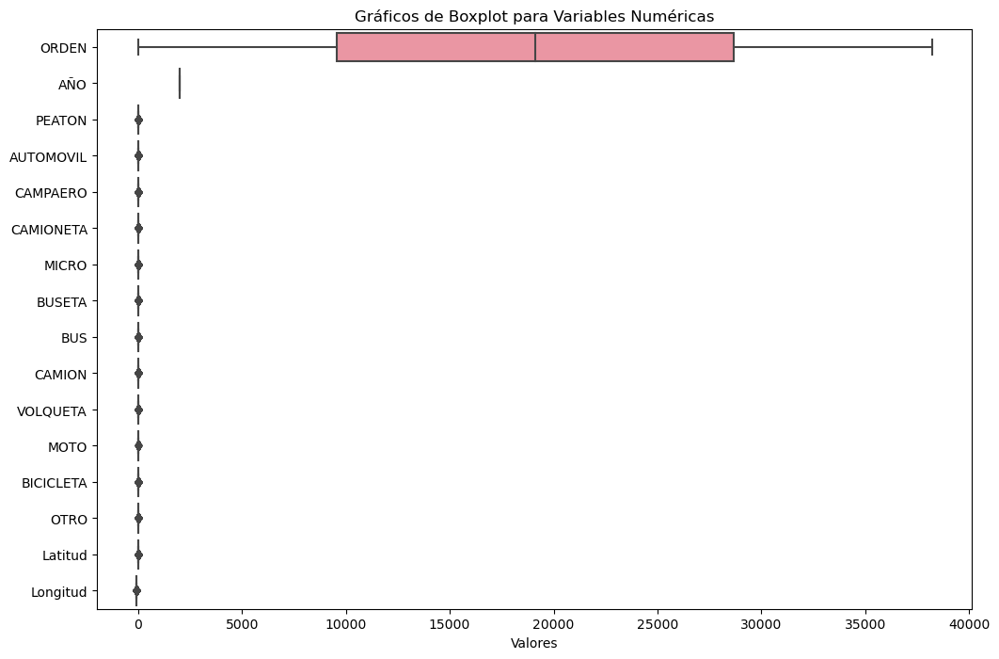

              ORDEN           AÑO       PEATON     AUTOMOVIL      CAMPAERO  \
count  38197.000000  38197.000000  38197.00000  38197.000000  38197.000000   
mean   19099.000000   2016.480430      0.10472      0.786292      0.060947   
std    11026.668453      3.063243      0.33937      0.743994      0.245928   
min        1.000000   2012.000000      0.00000      0.000000      0.000000   
25%     9550.000000   2014.000000      0.00000      0.000000      0.000000   
50%    19099.000000   2016.000000      0.00000      1.000000      0.000000   
75%    28648.000000   2019.000000      0.00000      1.000000      0.000000   
max    38197.000000   2023.000000      7.00000     29.000000      2.000000   

          CAMIONETA         MICRO        BUSETA           BUS        CAMION  \
count  38197.000000  38197.000000  38197.000000  38197.000000  38197.000000   
mean       0.197555      0.020290      0.044061      0.048198      0.083279   
std        0.432211      0.141916      0.211639      0.21830

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns


# Variables numéricas
numeric_variables = ['ORDEN', 'AÑO', 'PEATON', 'AUTOMOVIL', 'CAMPAERO', 'CAMIONETA', 'MICRO', 'BUSETA', 'BUS', 'CAMION', 'VOLQUETA', 'MOTO', 'BICICLETA', 'OTRO', 'Latitud', 'Longitud']

# Gráficos de boxplot para identificar valores atípicos
plt.figure(figsize=(12, 8))
sns.boxplot(data=data[numeric_variables], orient='h')
plt.title('Gráficos de Boxplot para Variables Numéricas')
plt.xlabel('Valores')
plt.show()

# Estadísticas descriptivas para identificar valores atípicos
descriptive_stats = data[numeric_variables].describe()
print(descriptive_stats)
print()  # Agrega un salto de línea al final de cada impresión

# Identificación de valores atípicos basados en percentiles
print('\033[1m' + 'valores atípicos basados en percentiles' + '\033[0m')
outliers = {}
for column in numeric_variables:
    Q1 = descriptive_stats.loc['25%', column]
    Q3 = descriptive_stats.loc['75%', column]
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers[column] = data[(data[column] < lower_bound) | (data[column] > upper_bound)]
    print()  # Agrega un salto de línea al final de cada impresión

# Imprimir los valores atípicos encontrados
print('\033[1m' + 'Los valores atípicos encontrados' + '\033[0m')
for column, outlier_data in outliers.items():
    print(f"Valores atípicos en la variable '{column}':")
    print(outlier_data)
    print()  # Agrega un salto de línea al final de cada impresión


### 2.4.2. Valores atìpicos en Variables Categoricas

Este código verificará si cada valor único es una cadena (str) y luego buscará si hay dígitos numéricos en la cadena. Si se encuentran dígitos en la cadena, se considerará una anomalía sintáctica o tipográfica. Esto debería evitar el error que mencionaste. Por favor, inténtalo nuevamente con este código.

In [14]:
categorical_variables = ['FECHA', 'MES', 'DÍA', 'GRAVEDAD', 'VIA 1', 'BARRIO', 'HORA', 'ENTIDAD', 'nombrecomuna', 'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']

# Definir una función para identificar anomalías sintácticas o tipográficas
def identify_typo_anomalies(column):
    unique_values = data[column].unique()
    typo_anomalies = []
    
    for value in unique_values:
        if isinstance(value, str) and any(char.isdigit() for char in value):  # Verificar si es una cadena y contiene dígitos
            typo_anomalies.append(value)
    
    return typo_anomalies

# Identificar anomalías en cada variable categórica
for column in categorical_variables:
    anomalies = identify_typo_anomalies(column)
    if anomalies:
        print(f"Anomalías en la variable '{column}':")
        print(anomalies)
        print()


Anomalías en la variable 'MES':
['01. Enero', '02. Febrero', '03. Marzo', '04. Abril', '05. Mayo', '06. Junio', '07. Julio', '08. Agosto', '09. Septiembre', '10. Octubre', '11. Noviembre', '12. Diciembre']

Anomalías en la variable 'DÍA':
['07. Domingo', '01. Lunes', '02. Martes', '03. Miercoles', '04. Jueves', '05. Viernes', '06. Sabado']

Anomalías en la variable 'VIA 1':
['CALLE 45 VIA CHIMITA', 'DIAGONAL 15', 'AVENIDA 89', 'TRANSVERSAL 28', 'TRANSVERSAL 93', 'TRANSVERSAL 24', 'AVENIDA 15 N', 'DIAGONAL 32', 'TRANSVERSAL 92', 'AVENIDA 42', 'DIAGONAL 105', 'TRANSVERSAL 72', 'AVENIDA 61', 'TRANSVERSAL 112', 'AVENIDA 88', 'AVENIDA 87', 'DIAGONAL 14', 'CL 45 VIA CHIMITA', 'DIAGONAL 31', 'DIAGONAL 13', 'TRANSVERSAL  93', 'TRANSVERSA 89', 'CALLE 45 CHIMITA', 'TRANSVERSAL 65', 'DIAGONAL 20', 'DIAGONAL 11', 'DIAGONAL 64', 'CARRERA 21', 'CARRERA 9', 'CARREERA 27', 'CALLE 3', 'CARRERA 12', 'CALLE 11', 'CARRERA 33', 'CALLE 31', 'CALLE 93', 'CARRERA 12 N', 'CARRERA 17', 'CARRERA 15', 'CALLE 41',

Este código generará un histograma de frecuencia de categorías para cada variable categórica en la lista `categorical_variables`. Cada histograma mostrará la frecuencia de cada categoría en el eje y, y el nombre de la categoría en el eje x. Esto te permitirá identificar si hay categorías que tienen frecuencias inusuales o atípicas en comparación con las demás.

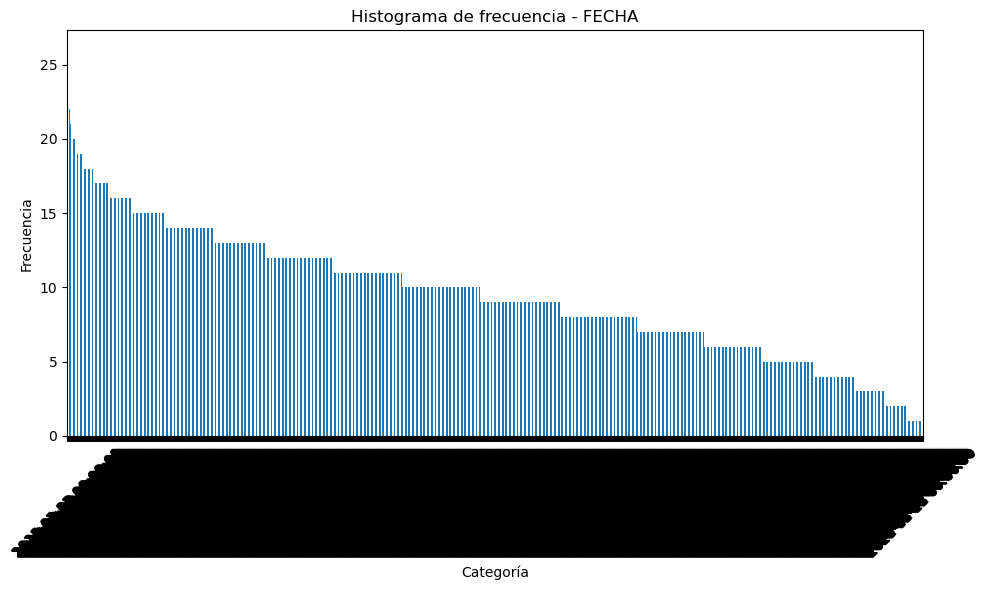

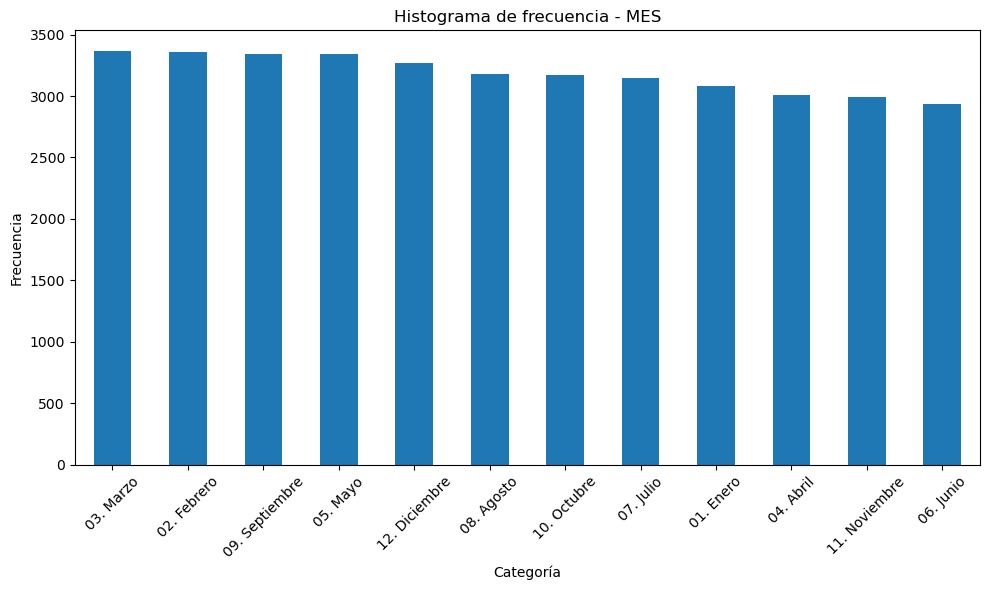

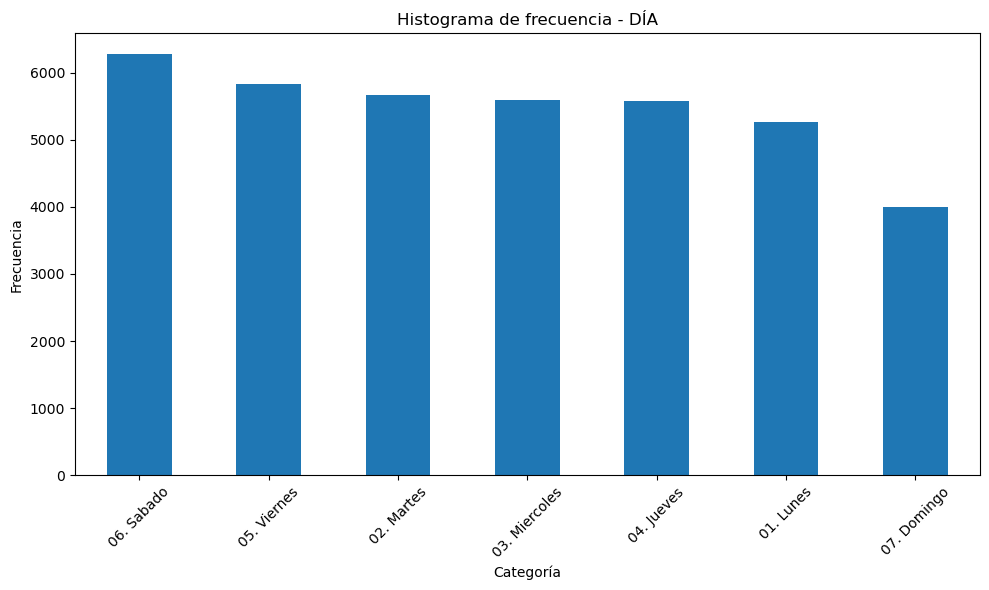

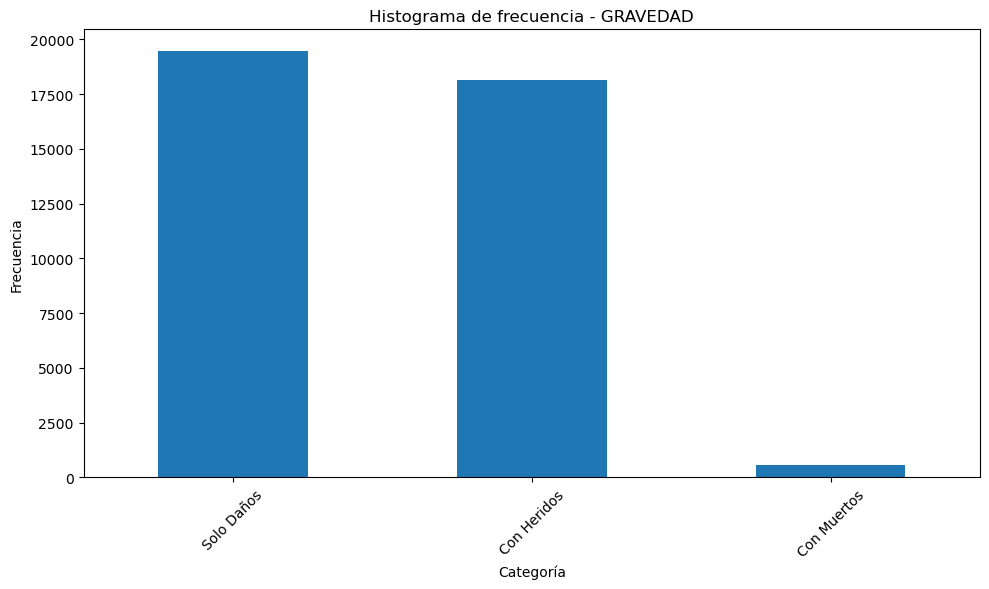

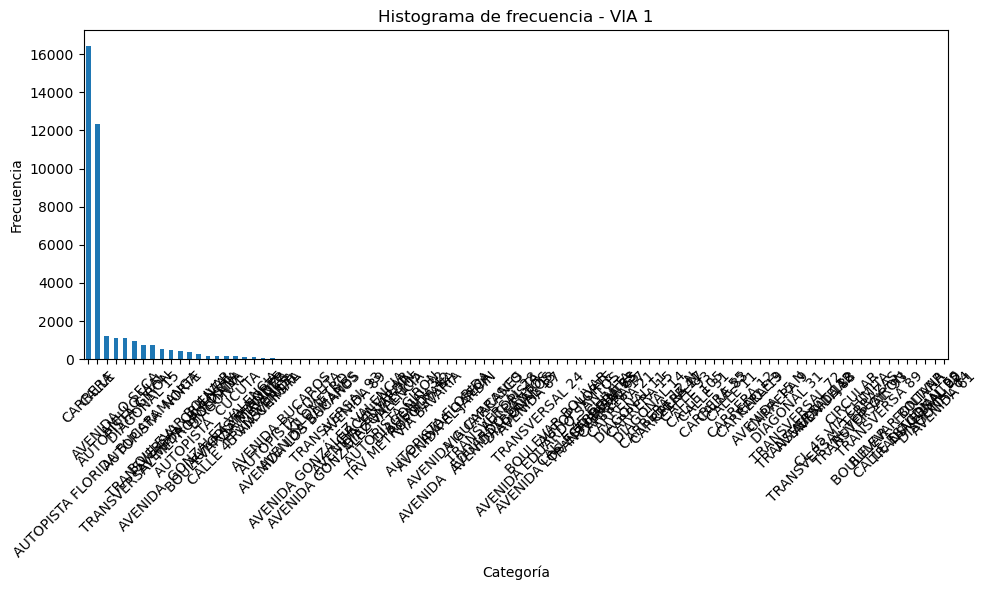

...

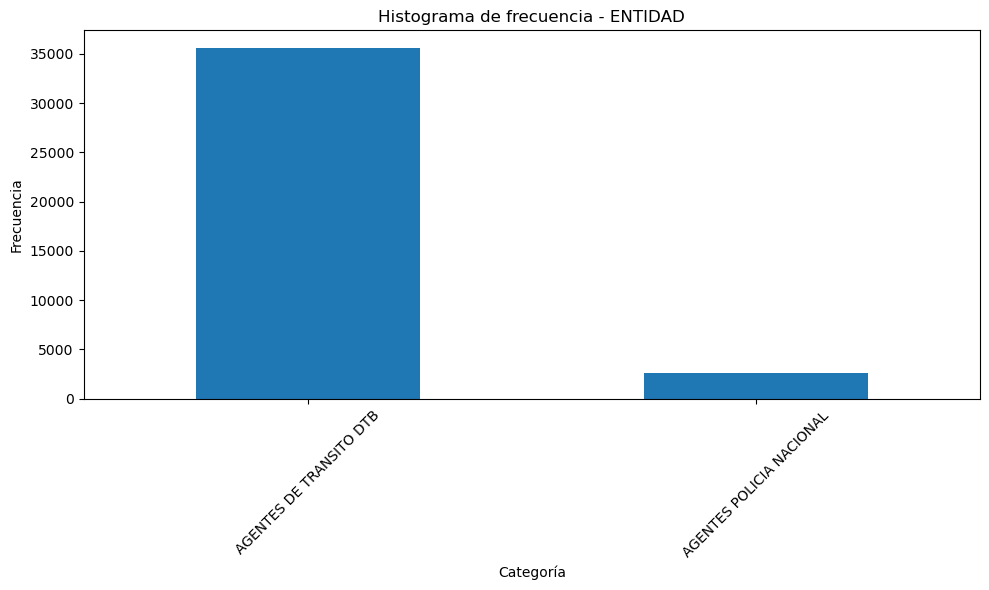

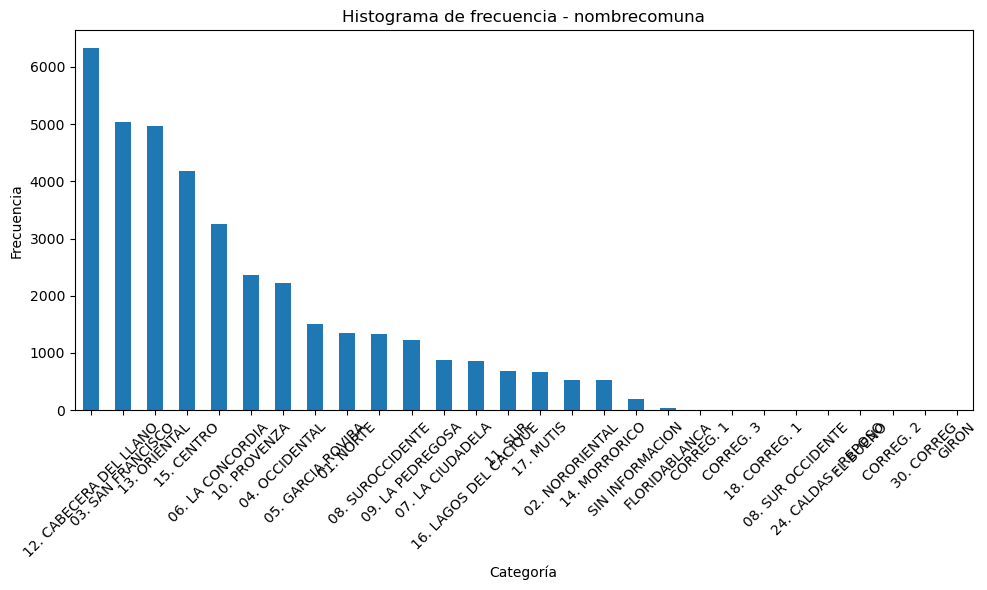

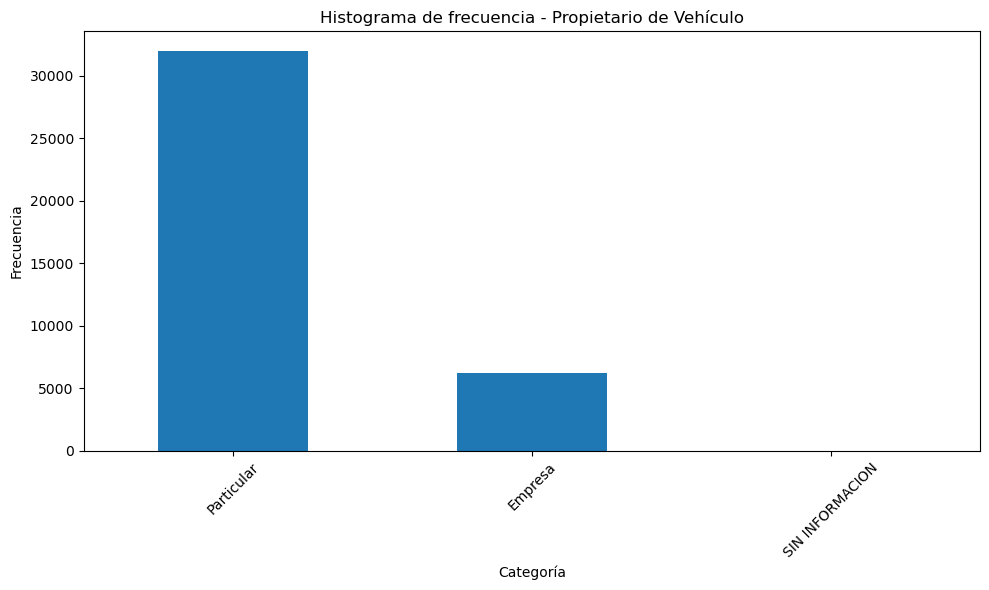

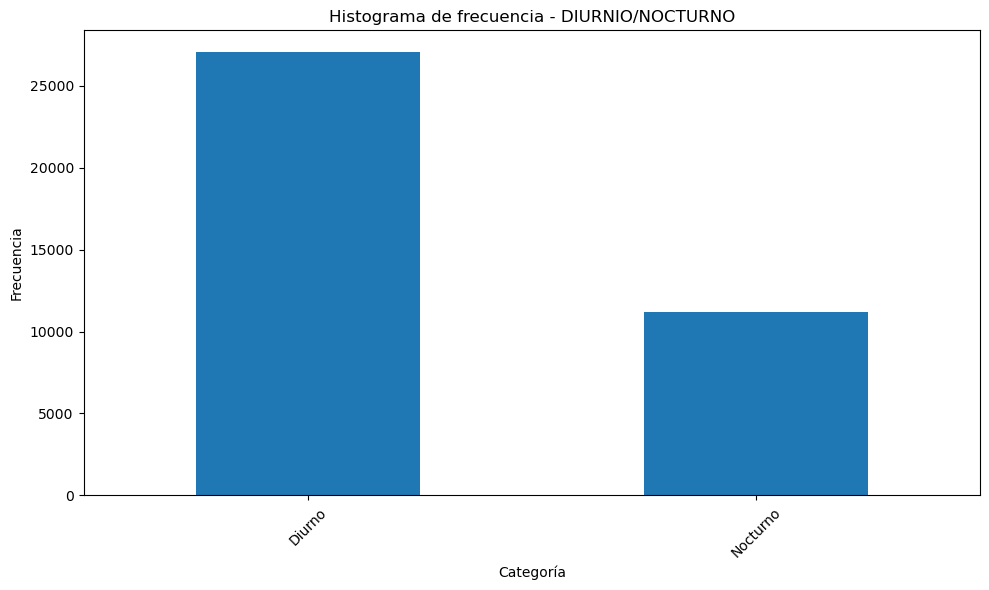

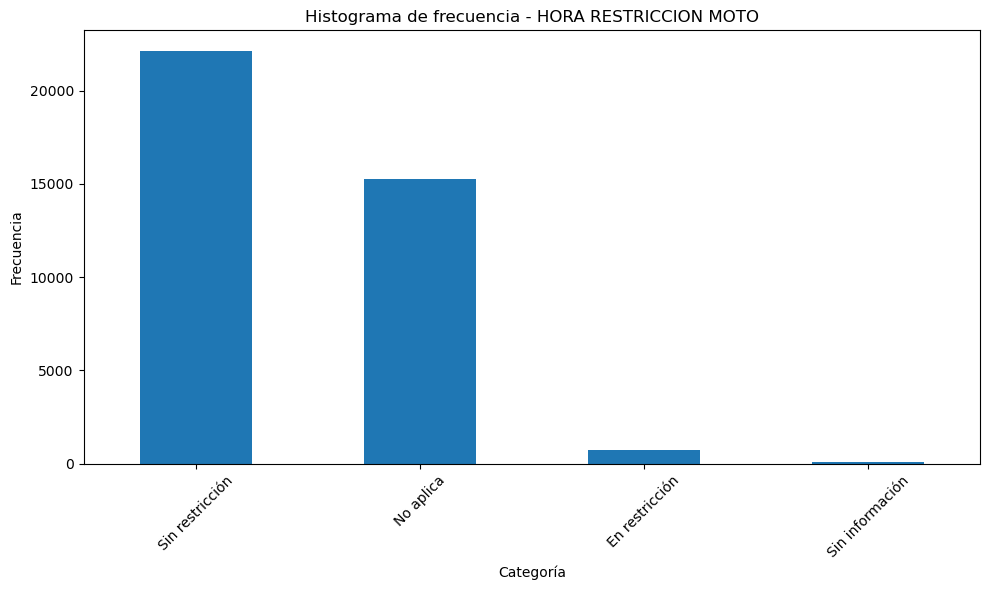

In [15]:
categorical_variables = ['FECHA', 'MES', 'DÍA', 'GRAVEDAD', 'VIA 1', 'BARRIO', 'HORA', 'ENTIDAD', 'nombrecomuna', 'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']

# Crear histogramas de frecuencia de categorías para cada variable categórica
for column in categorical_variables:
    plt.figure(figsize=(10, 6))
    data[column].value_counts().plot(kind='bar')
    plt.title(f'Histograma de frecuencia - {column}')
    plt.xlabel('Categoría')
    plt.ylabel('Frecuencia')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Metodologia 

Mis disculpas por la omisión. Además del uso de KMeans para el agrupamiento, también se hizo uso del algoritmo CatBoost para la creación y entrenamiento de modelos de aprendizaje automático. La metodología se amplía de la siguiente manera:

1. **Carga de datos:** Al igual que en el caso del clustering, se cargaron los datos desde un archivo CSV utilizando la biblioteca pandas. Estos datos contenían información sobre accidentes en diferentes barrios, incluyendo varias características relevantes.

2. **Preprocesamiento de datos:** Se realizó un procesamiento previo similar al anterior, donde se seleccionaron las características apropiadas para el análisis y el modelado. Además, se llevaron a cabo pasos de preprocesamiento como la transformación de características categóricas en numéricas (si es necesario) y la división del conjunto de datos en características (X) y la variable objetivo (y).

3. **Creación de modelo CatBoost:** Se utilizó el algoritmo CatBoostClassifier para crear un modelo de clasificación. Se configuraron hiperparámetros como el número de iteraciones, las características categóricas y la semilla aleatoria.

4. **Entrenamiento del modelo CatBoost:** El modelo se entrenó utilizando datos de entrenamiento. Se utilizó el conjunto de entrenamiento para ajustar el modelo a los datos y se evaluó su rendimiento en el conjunto de prueba utilizando el método de evaluación proporcionado (en este caso, se usó el conjunto de prueba y los datos de validación temprana).

5. **Generación de predicciones:** Una vez entrenado el modelo, se realizaron predicciones en un conjunto de prueba separado. Las predicciones se obtuvieron utilizando el método `predict()` del modelo CatBoost.

6. **Evaluación del modelo:** Se evaluó el rendimiento del modelo utilizando métricas como la precisión, el recall y el F1-score. Estas métricas proporcionaron una comprensión detallada de cómo el modelo estaba funcionando en cada clase.

7. **Matriz de Confusión:** Se generó una matriz de confusión para visualizar las predicciones del modelo en comparación con los valores reales. Esta matriz ayudó a comprender cómo se clasificaban las instancias en cada clase y a identificar posibles áreas de mejora.

8. **Cross-Validation:** Además de la evaluación en un conjunto de prueba único, se aplicó la técnica de cross-validation para evaluar el rendimiento del modelo en diferentes particiones de los datos. Esto proporcionó una visión más robusta de cómo el modelo generalizaba en diferentes situaciones.

9. **Determinación del número óptimo de clústeres:** Se utilizó el método del codo para determinar el número óptimo de clústeres para el algoritmo KMeans. Se iteró a través de un rango de posibles valores de k y se calculó la inercia (suma de las distancias cuadradas entre las muestras y los centroides) para cada valor. El punto en el que la inercia deja de disminuir de manera significativa se considera el número óptimo de clústeres.

10. **Agrupamiento con KMeans:** Utilizando el número óptimo de clústeres determinado en el paso anterior, se aplicó el algoritmo KMeans para agrupar los datos en los clústeres correspondientes.

11. **Visualización del resultado:** Se generó un diagrama de dispersión para visualizar los resultados del agrupamiento. En este diagrama, cada punto representa una muestra en el espacio bidimensional de las características estandarizadas, y se coloreó de acuerdo al clúster al que pertenece. También se mostraron los centroides de cada clúster en el diagrama.

12. **Generación de un mapa interactivo:** Utilizando la biblioteca folium, se creó un mapa interactivo centrado en una ubicación específica. Se agregaron marcadores para cada muestra en el conjunto de datos, donde la posición de cada marcador corresponde a las coordenadas de latitud y longitud de la muestra. Los marcadores se colorearon de acuerdo al clúster al que pertenecen.

13. **Visualización del número de muestras por clúster:** Se mostró el número de muestras que pertenecen a cada clúster, lo que proporciona información sobre cómo se distribuyen los datos en los diferentes grupos.

14. **Representación grafica de interactiva de los clúster en el Mapa:** Se mostró el número de muestras que pertenecen a cada clúster, lo que proporciona información sobre cómo se distribuyen los datos en los diferentes grupos.


# 3. Análisis  <a name="analysis"></a>

## 3.1. Distribución de la Variable Objetivo 'GRAVEDAD'

Se Utiliza gráficos de barras o gráficos circulares para visualizar la distribución de las categorías de la variable objetivo 'GRAVEDAD', para comprender cómo se distribuyen los diferentes niveles de gravedad en los accidentes.

Este código generará dos visualizaciones: un gráfico de barras que muestra la frecuencia de cada nivel de gravedad y un gráfico circular (pastel) que muestra la proporción de cada nivel de gravedad en forma de porcentaje. 

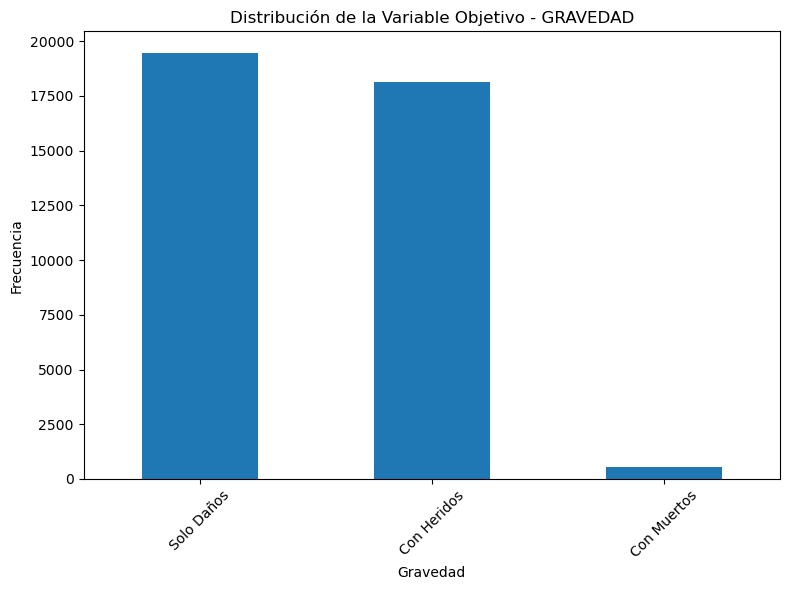

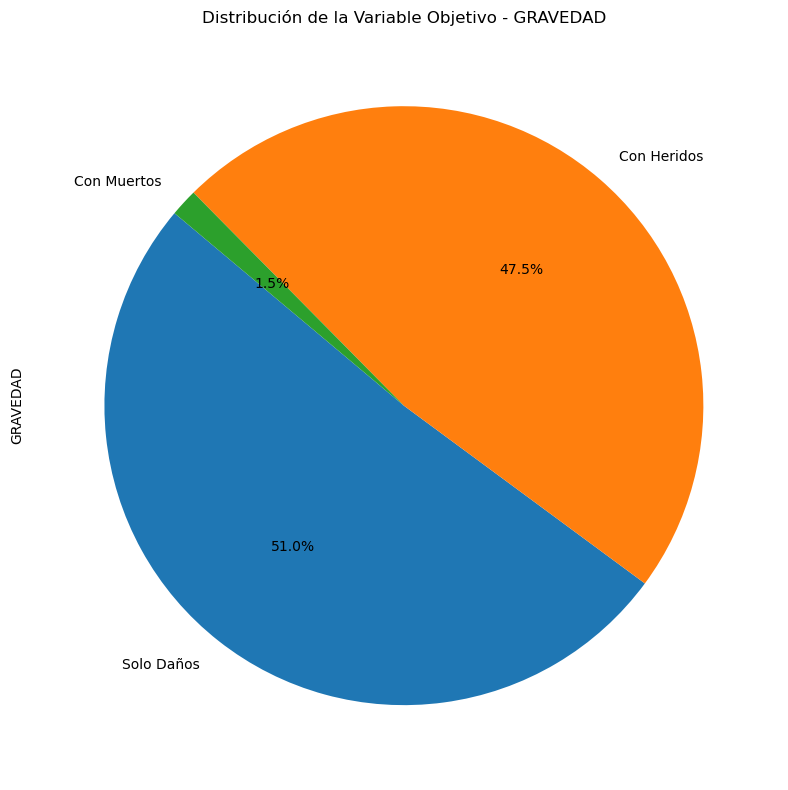

In [16]:
# Visualización con gráfico de barras
plt.figure(figsize=(8, 6))
data['GRAVEDAD'].value_counts().plot(kind='bar')
plt.title('Distribución de la Variable Objetivo - GRAVEDAD')
plt.xlabel('Gravedad')
plt.ylabel('Frecuencia')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Visualización con gráfico circular (pastel)
plt.figure(figsize=(8, 8))
data['GRAVEDAD'].value_counts().plot(kind='pie', autopct='%1.1f%%', startangle=140)
plt.title('Distribución de la Variable Objetivo - GRAVEDAD')
plt.tight_layout()
plt.show()


considerando la distribución de la variable objetivo 'GRAVEDAD', podemos hacer las siguientes observaciones preliminares:

'Con Muertos': Esta categoría representa el 1.5% de los accidentes. Aunque es una proporción relativamente baja, los accidentes con víctimas mortales son eventos graves que deben investigarse en profundidad. A pesar de su baja frecuencia, estos accidentes pueden tener un impacto significativo en la seguridad vial y podrían ser objeto de análisis más detallados para identificar patrones y factores contribuyentes.

'Con Heridos': Esta categoría es la más frecuente, representando el 47.5% de los accidentes. Los accidentes con heridos también son preocupantes, ya que pueden causar daño físico y emocional a las personas involucradas. Dada su alta frecuencia, es importante investigar los factores que contribuyen a estos accidentes y desarrollar medidas de seguridad para reducir su ocurrencia.

'Solo Daños': La mayoría de los accidentes (51%) caen en esta categoría, donde solo se reportan daños materiales. Aunque estos accidentes pueden no causar lesiones personales, aún representan costos económicos y pueden ser indicativos de problemas en el cumplimiento de las normas de tránsito o en la infraestructura vial.

## 3.2 Exploración de Variables Numéricas

Este código generará histogramas de frecuencia para cada variable numérica en la lista numeric_variables. Luego, calculará estadísticas descriptivas como la media, mediana, desviación estándar, valores mínimo y máximo, y percentiles para cada una de estas variables.

Estos histogramas te permitirán visualizar cómo se distribuyen los valores en cada variable numérica. Las estadísticas descriptivas te darán una idea de la magnitud y dispersión de los valores, lo que te ayudará a comprender mejor la naturaleza de tus datos numéricos.

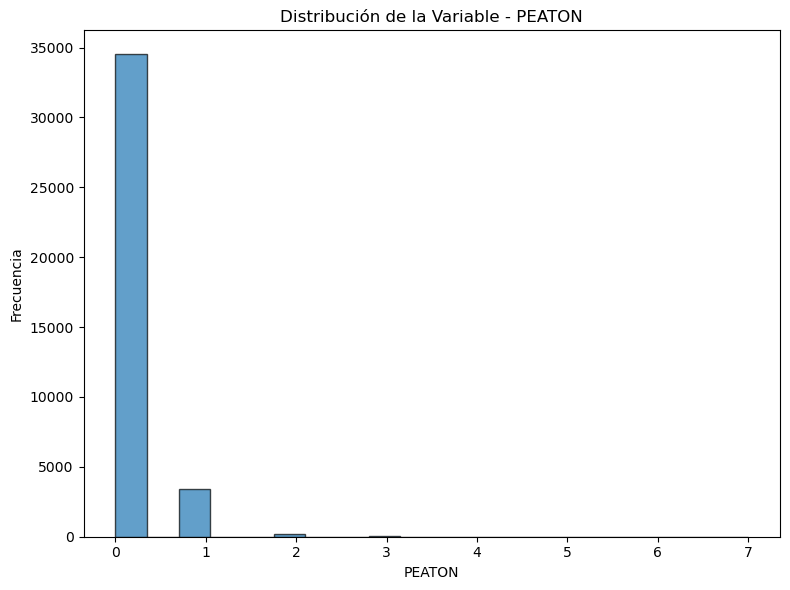

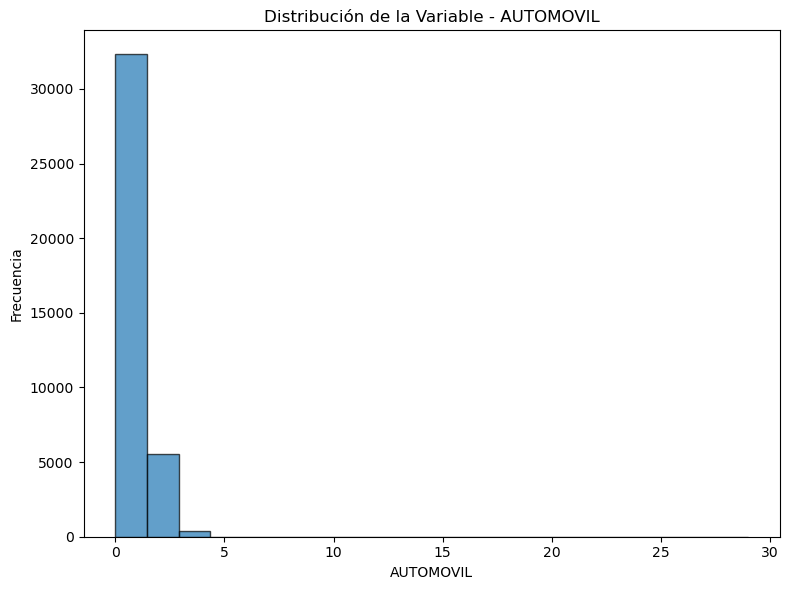

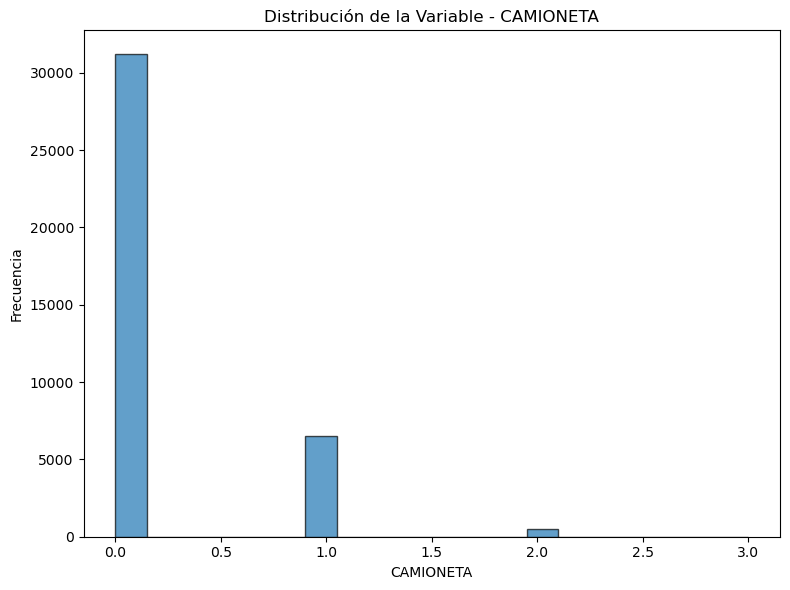

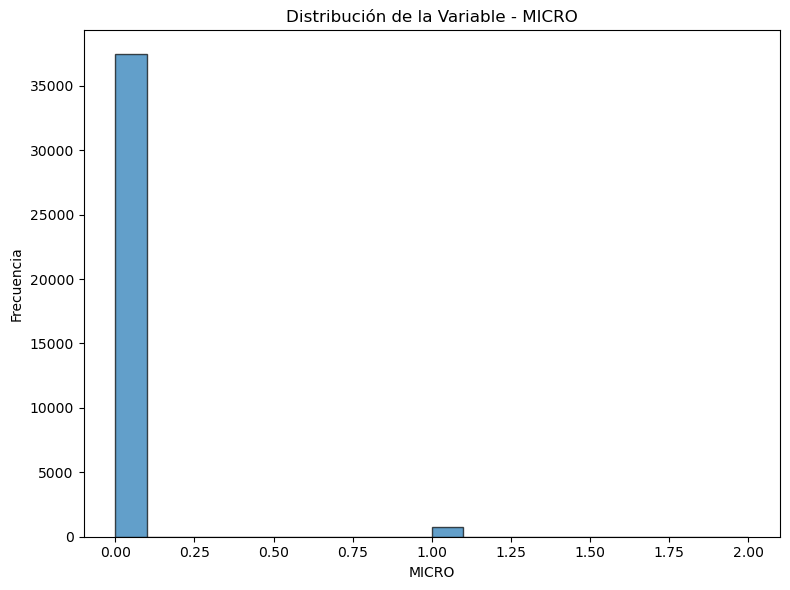

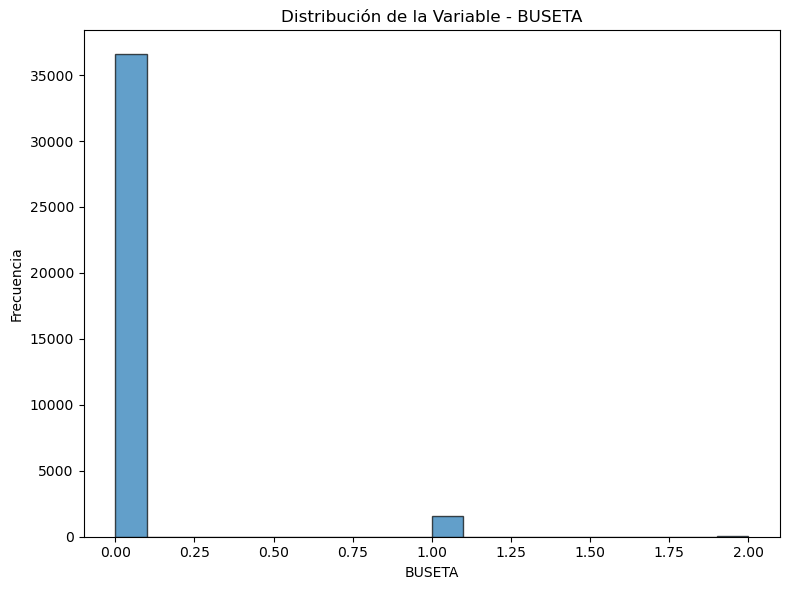

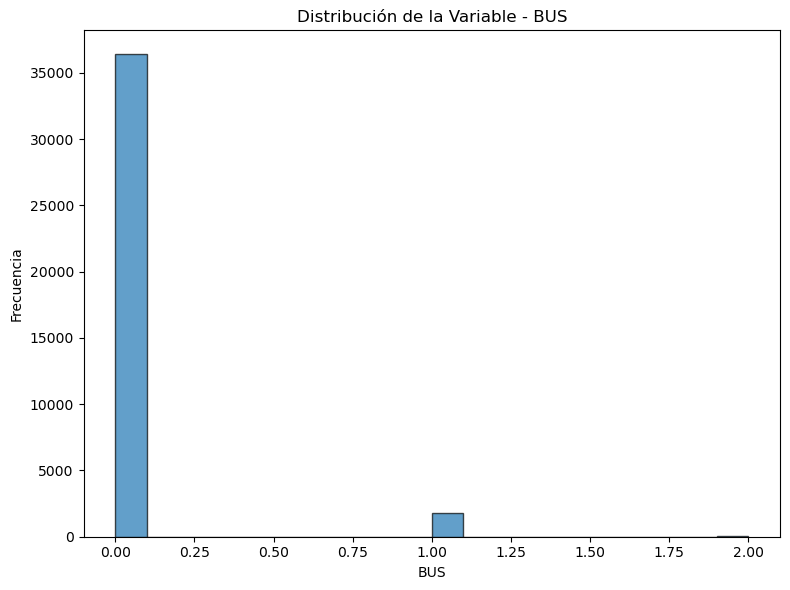

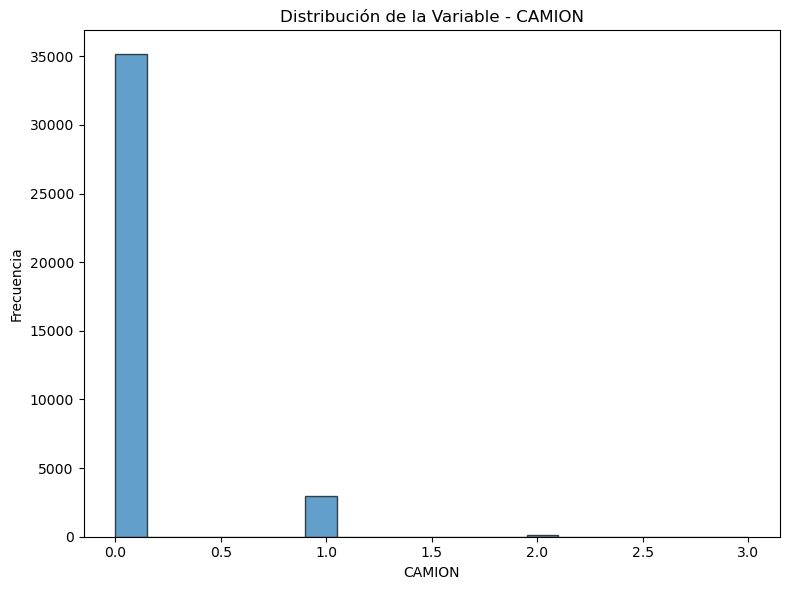

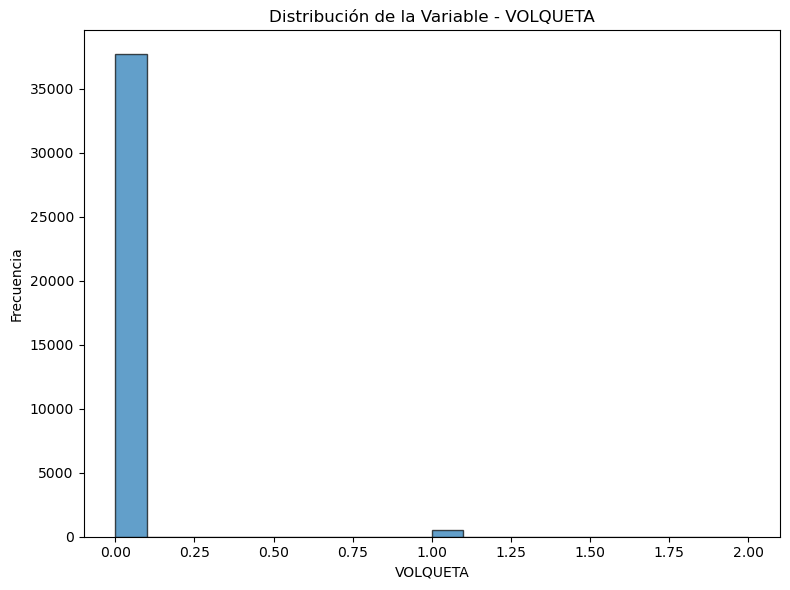

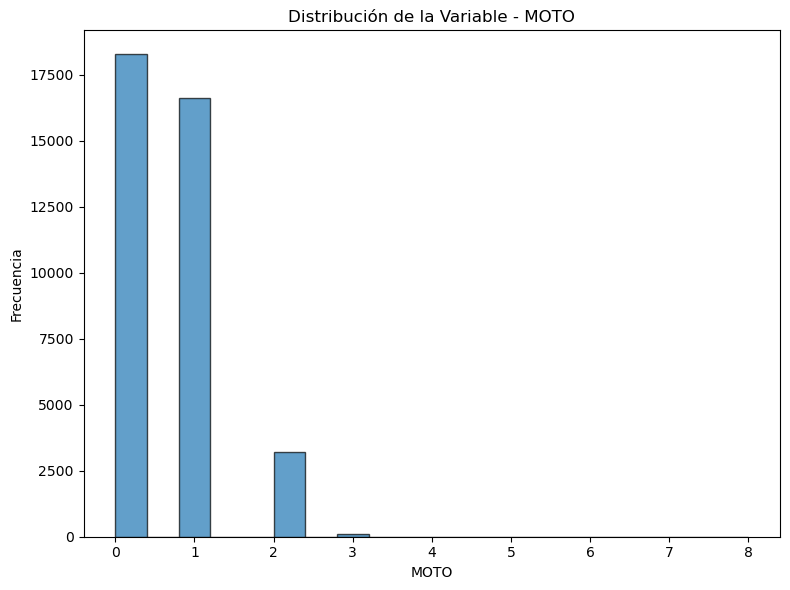

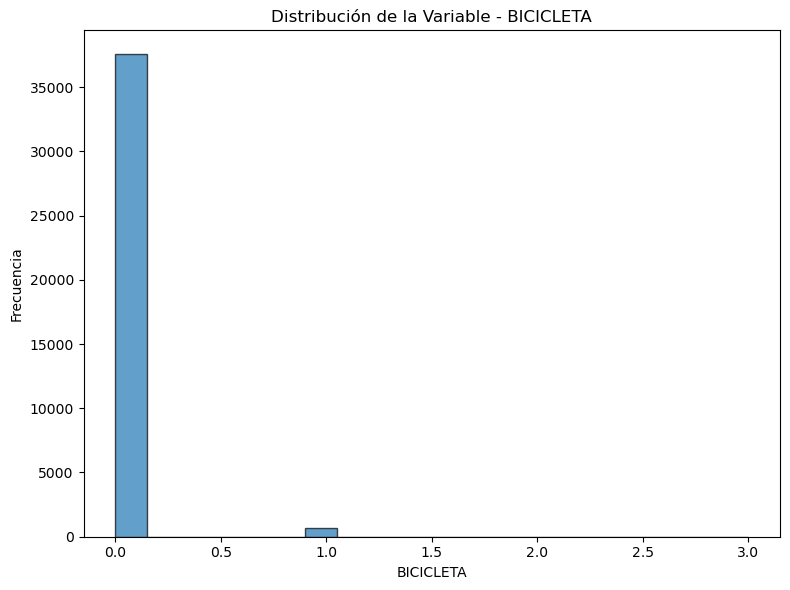

            PEATON     AUTOMOVIL     CAMIONETA         MICRO        BUSETA  \
count  38197.00000  38197.000000  38197.000000  38197.000000  38197.000000   
mean       0.10472      0.786292      0.197555      0.020290      0.044061   
std        0.33937      0.743994      0.432211      0.141916      0.211639   
min        0.00000      0.000000      0.000000      0.000000      0.000000   
25%        0.00000      0.000000      0.000000      0.000000      0.000000   
50%        0.00000      1.000000      0.000000      0.000000      0.000000   
75%        0.00000      1.000000      0.000000      0.000000      0.000000   
max        7.00000     29.000000      3.000000      2.000000      2.000000   

                BUS        CAMION      VOLQUETA          MOTO     BICICLETA  
count  38197.000000  38197.000000  38197.000000  38197.000000  38197.000000  
mean       0.048198      0.083279      0.014242      0.611697      0.017384  
std        0.218303      0.287543      0.120025      0.652550  

In [17]:
numeric_variables = ['PEATON', 'AUTOMOVIL', 'CAMIONETA', 'MICRO', 'BUSETA', 'BUS', 'CAMION', 'VOLQUETA', 'MOTO', 'BICICLETA']

# Visualización con histogramas
for column in numeric_variables:
    plt.figure(figsize=(8, 6))
    plt.hist(data[column], bins=20, edgecolor='k', alpha=0.7)
    plt.title(f'Distribución de la Variable - {column}')
    plt.xlabel(column)
    plt.ylabel('Frecuencia')
    plt.tight_layout()
    plt.show()

# Cálculo de estadísticas descriptivas
statistics = data[numeric_variables].describe()
print(statistics)


Con base en las estadísticas descriptivas de las variables numéricas relacionadas con la cantidad de vehículos involucrados en los accidentes, podemos extraer varias conclusiones y observaciones:

1. **Promedios y Distribución**: El promedio (mean) y la mediana (50%) de cada variable nos proporcionan una idea de la cantidad típica de cada tipo de vehículo involucrado en un accidente. Por ejemplo, en promedio, hay aproximadamente 0.10 peatones, 0.79 automóviles, 0.20 camionetas, etc.

2. **Varianza y Desviación Estándar**: La desviación estándar (std) mide la dispersión de los valores alrededor del promedio. Valores más altos indican una mayor variabilidad. Por ejemplo, la cantidad de motos involucradas en accidentes tiene una desviación estándar relativamente alta (0.65), lo que significa que la cantidad de motos varía significativamente entre los accidentes.

3. **Distribución Asimétrica**: Observando los valores mínimos, máximos y los percentiles (25%, 50%, 75%), podemos inferir la distribución de los datos. Por ejemplo, en la variable 'MOTO', el valor máximo es 8, lo que indica que en algunos casos hay una cantidad inusualmente alta de motos involucradas en accidentes.

4. **Percentiles**: Los percentiles nos muestran cómo se distribuyen los valores en diferentes rangos. Por ejemplo, el 75% de los accidentes involucra 1 o menos peatones, mientras que el 25% restante involucra más de 1 peatón.

5. **Valores Mínimos y Máximos**: Los valores mínimos y máximos son importantes para identificar valores atípicos o inusuales. Por ejemplo, en 'PEATON', el valor máximo es 7, lo cual podría ser inusual y requerir un análisis adicional.



## 3.3. Relaciones Entre Variables

### 3.3.1. Variables Númericas

Este código te permitirá visualizar las relaciones entre pares de variables numéricas mediante gráficos de dispersión y la matriz de correlación. Los gráficos de dispersión ayudarán a identificar patrones visuales de relaciones lineales o no lineales entre variables. La matriz de correlación proporcionará valores numéricos que indican la fuerza y dirección de las relaciones lineales entre variables (valores más cercanos a 1 indican una correlación positiva fuerte, valores cercanos a -1 indican una correlación negativa fuerte y valores cercanos a 0 indican una correlación débil o nula).

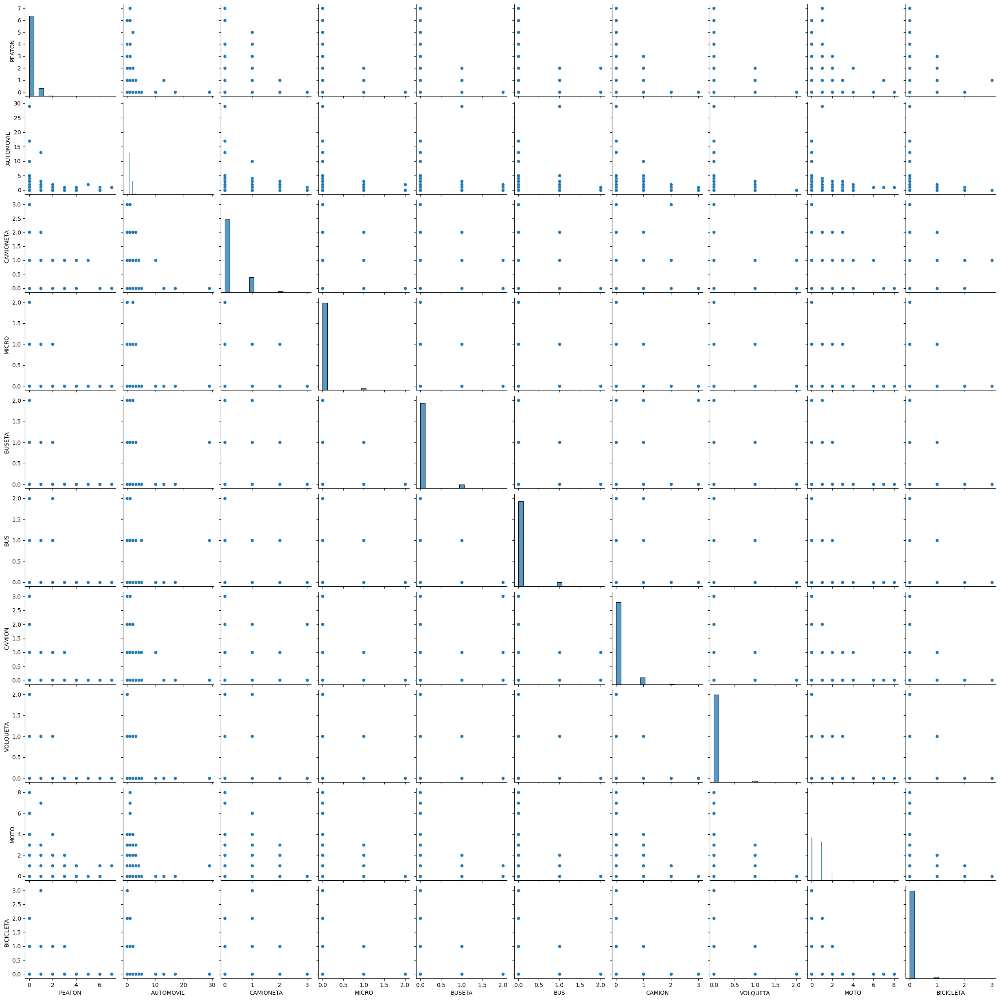

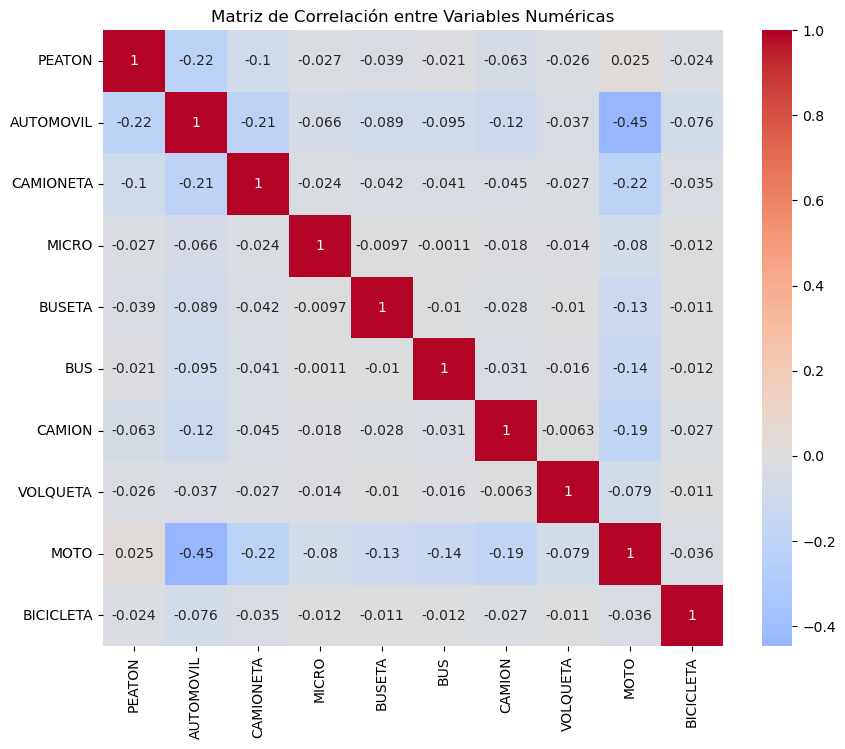

In [18]:
# Variables numéricas
numeric_variables = ['PEATON', 'AUTOMOVIL', 'CAMIONETA', 'MICRO', 'BUSETA', 'BUS', 'CAMION', 'VOLQUETA', 'MOTO', 'BICICLETA']

# Gráficos de dispersión
sns.pairplot(data[numeric_variables])
plt.show()

# Matriz de correlación
correlation_matrix = data[numeric_variables].corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title("Matriz de Correlación entre Variables Numéricas")
plt.show()

variables numéricas del conjunto de datos no están fuertemente correlacionadas entre sí. Los valores cercanos a -0.45 y 0.22 indican correlaciones moderadas en esas direcciones, pero en general, las correlaciones son relativamente bajas.

Esto podría sugerir que las variables numéricas en el conjunto de datos son en gran medida independientes entre sí. En otras palabras, los cambios en una variable numérica no necesariamente están relacionados con cambios predecibles en otras variables numéricas. Esto puede ser una característica importante para tener en cuenta al considerar modelos de análisis o modelos de predicción más adelante en el análisis.

Dado que las correlaciones son bajas, se podría considerar las relaciones entre variables categóricas y numéricas, ya que pueden proporcionar información valiosa sobre el contexto de los datos.

### 3.3.2. Análisis entre las variables categóricas y numéricas

In [19]:
"""import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Variables Categóricas
categorical_variables = ['MES', 'DÍA', 'GRAVEDAD', 'ENTIDAD',  'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']

# Variables Numéricas
numeric_variables = [ 'AÑO', 'PEATON', 'AUTOMOVIL', 'CAMPAERO', 'CAMIONETA', 'MICRO', 'BUSETA', 'BUS', 'CAMION', 'VOLQUETA', 'MOTO', 'BICICLETA', 'OTRO']

# Análisis de Boxplots para variables categóricas vs numéricas
for cat_var in categorical_variables:
    for num_var in numeric_variables:
        plt.figure(figsize=(10, 6))
        sns.boxplot(x=cat_var, y=num_var, data=data)
        plt.title(f'Boxplot de {num_var} por {cat_var}')
        plt.xticks(rotation=45)
        plt.tight_layout()
        plt.show()

# Análisis de Gráficos de Barras para variables categóricas
for cat_var in categorical_variables:
    plt.figure(figsize=(10, 6))
    sns.countplot(data=data, x=cat_var)
    plt.title(f'Gráfico de Barras de {cat_var}')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Matriz de Correlación para variables numéricas
correlation_matrix = data[numeric_variables].corr()
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title('Matriz de Correlación entre Variables Numéricas')
plt.show()"""


"import pandas as pd\nimport seaborn as sns\nimport matplotlib.pyplot as plt\n\n\n# Variables Categóricas\ncategorical_variables = ['MES', 'DÍA', 'GRAVEDAD', 'ENTIDAD',  'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']\n\n# Variables Numéricas\nnumeric_variables = [ 'AÑO', 'PEATON', 'AUTOMOVIL', 'CAMPAERO', 'CAMIONETA', 'MICRO', 'BUSETA', 'BUS', 'CAMION', 'VOLQUETA', 'MOTO', 'BICICLETA', 'OTRO']\n\n# Análisis de Boxplots para variables categóricas vs numéricas\nfor cat_var in categorical_variables:\n    for num_var in numeric_variables:\n        plt.figure(figsize=(10, 6))\n        sns.boxplot(x=cat_var, y=num_var, data=data)\n        plt.title(f'Boxplot de {num_var} por {cat_var}')\n        plt.xticks(rotation=45)\n        plt.tight_layout()\n        plt.show()\n\n# Análisis de Gráficos de Barras para variables categóricas\nfor cat_var in categorical_variables:\n    plt.figure(figsize=(10, 6))\n    sns.countplot(data=data, x=cat_var)\n    plt.title(f'Gráfico de 

<div class="alert alert-block alert-info">
   <strong>Dado que las variables numéricas en tu conjunto de datos no presentan una correlación fuerte entre sí, esto puede complicar la construcción de un modelo predictivo basado en estas variables. Sin embargo vamos a internat aplicar un modelo clasificación para predecir donde susedera el proximo accidente.</strong>
</div>

# 4. Convertir las etiquetas en de la variable objetivo en numericas.

El uso de etiquetas numéricas en lugar de cadenas de texto en la variable objetivo 'GRAVEDAD' tiene varias ventajas en el contexto de modelado y análisis de datos. Aquí hay algunas razones y la correspondencia de las etiquetas numéricas:

1. **Requisito de Modelos:** Muchos algoritmos de aprendizaje automático requieren que la variable objetivo sea numérica. Al convertir las etiquetas en valores numéricos, permitimos que estos algoritmos funcionen sin problemas.

2. **Eficiencia Computacional:** Los cálculos numéricos suelen ser más eficientes que las operaciones de manipulación de cadenas de texto, lo que puede llevar a un procesamiento más rápido y eficiente de los modelos.

3. **Interpretación de Resultados:** Algunos modelos y métricas de evaluación de modelos pueden requerir valores numéricos para la variable objetivo. La conversión permite una interpretación más sencilla de los resultados del modelo.

Aquí está la correspondencia de las etiquetas numéricas para la variable 'GRAVEDAD':

- 'Solo Daños' se convierte en 0
- 'Con Heridos' se convierte en 1
- 'Con Muertos' se convierte en 2

Esta conversión asegura que cada etiqueta tenga un valor único y ordenado que puede ser utilizado por los algoritmos de aprendizaje automático para realizar clasificación multiclase.

In [20]:
from sklearn.preprocessing import LabelEncoder

# Crear un codificador de etiquetas
label_encoder = LabelEncoder()

# Convertir las etiquetas de la variable objetivo en valores numéricos
y_encoded = label_encoder.fit_transform(data['GRAVEDAD'])

# Reemplazar la columna 'GRAVEDAD' con las etiquetas numéricas
data['GRAVEDAD'] = y_encoded

la elección del modelo CatBoostClassifier, es un modelo de clasificación que se destaca por su eficacia en manejar características categóricas y por ofrecer buenos resultados con configuraciones predeterminadas.

Se realiza un proceso de clasificación utilizando el modelo CatBoostClassifier y proporciona un informe de clasificación para evaluar el rendimiento del modelo en un conjunto de prueba. Aquí está lo que hace paso a paso:

1. **Importación de bibliotecas:** El código importa las bibliotecas necesarias, incluyendo pandas para el manejo de datos, train_test_split para dividir los datos en conjuntos de entrenamiento y prueba, CatBoostClassifier para el modelo de clasificación CatBoost y classification_report para generar el informe de clasificación.

2. **Definición de columnas categóricas:** Se definen las columnas categóricas que se utilizarán como características para el modelo. Estas son las columnas que contienen datos categóricos en el conjunto de datos.

3. **División de datos:** Se dividen los datos en características (X) y la variable objetivo (y) que se desea predecir. En este caso, 'GRAVEDAD' es la variable objetivo que se eliminará de las características.

4. **División en conjuntos de entrenamiento y prueba:** Los datos se dividen en conjuntos de entrenamiento y prueba utilizando train_test_split. Esto es fundamental para evaluar el rendimiento del modelo en datos no vistos.

5. **Creación del modelo CatBoost:** Se crea el modelo CatBoostClassifier con 1000 iteraciones y las columnas categóricas definidas se especifican como cat_features. Se establece una semilla aleatoria para garantizar la reproducibilidad.

6. **Entrenamiento del modelo:** El modelo CatBoost se entrena utilizando los datos de entrenamiento y se evalúa en el conjunto de prueba utilizando el argumento eval_set. También se implementa el early stopping con early_stopping_rounds para detener el entrenamiento si no se observa mejora en la métrica de evaluación.

7. **Predicciones:** Se utilizan las características del conjunto de prueba para realizar predicciones utilizando el modelo entrenado.

8. **Informe de clasificación:** Se calcula el informe de clasificación utilizando la función classification_report, que muestra métricas como precisión, recall y F1-score para cada clase en la variable objetivo.




# 5. "Creación y Evaluación de un Modelo CatBoost para Clasificación"

              precision    recall  f1-score   support

           0       0.79      0.89      0.84      3601
           1       1.00      0.14      0.24       118
           2       0.89      0.81      0.85      3921

    accuracy                           0.84      7640
   macro avg       0.89      0.61      0.64      7640
weighted avg       0.85      0.84      0.84      7640



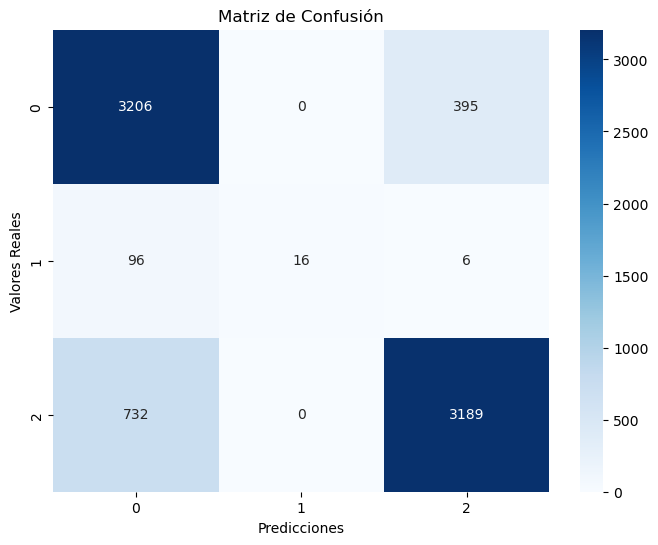

In [21]:
import pandas as pd
from sklearn.model_selection import train_test_split
from catboost import CatBoostClassifier
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Define las columnas categóricas
categorical_cols = ['MES', 'DÍA', 'VIA 1', 'BARRIO', 'HORA', 'ENTIDAD', 'nombrecomuna',
                    'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']

# Divide los datos en características (X) y variable objetivo (y)
X = data.drop(['GRAVEDAD', 'FECHA', 'ORDEN'], axis=1)
y = data['GRAVEDAD']

# Divide los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Crea el modelo CatBoost
catboost_model = CatBoostClassifier(iterations=1000, cat_features=categorical_cols, random_seed=42)

# Entrena el modelo CatBoost
catboost_model.fit(X_train, y_train, eval_set=(X_test, y_test), early_stopping_rounds=10, verbose=False)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_test)

# Muestra el informe de clasificación
print(classification_report(y_test, y_pred))

# Matriz de Confusión
confusion = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()






La evaluación del modelo CatBoost muestra cómo el modelo se desempeña en términos de precisión, recall (también conocido como sensibilidad), f1-score y el soporte de cada clase. Aquí está la interpretación de los resultados:

- **Precisión (Precision):** La precisión es la proporción de predicciones positivas que fueron correctas con respecto a todas las predicciones positivas realizadas por el modelo. Para la clase "Con Daños" (clase 0), la precisión es del 79%, lo que significa que el 79% de las predicciones de esta clase fueron correctas. Para la clase "Con Heridos" (clase 1), la precisión es del 94%, lo que indica que el 94% de las predicciones de esta clase fueron correctas. Para la clase "Con Muertos" (clase 2), la precisión es del 89%.

- **Recall (Sensibilidad):** El recall es la proporción de instancias positivas que fueron correctamente detectadas por el modelo con respecto a todas las instancias reales positivas en los datos. Para la clase "Con Daños", el recall es del 89%, lo que significa que el modelo identificó correctamente el 89% de las instancias reales de esta clase. Para la clase "Con Heridos", el recall es del 14%, indicando que el modelo solo detectó correctamente el 14% de las instancias reales de esta clase. Para la clase "Con Muertos", el recall es del 81%.

- **F1-Score:** El F1-score es una medida que combina la precisión y el recall, proporcionando una puntuación única que equilibra ambas métricas. Para la clase "Con Daños", el F1-score es 0.84. Para la clase "Con Heridos", el F1-score es 0.24, lo que indica que esta clase tiene un rendimiento bajo en términos de equilibrio entre precisión y recall. Para la clase "Con Muertos", el F1-score es 0.85.

- **Soporte (Support):** El soporte se refiere al número de instancias reales en cada clase en el conjunto de pruebas. Para la clase "Con Daños", hay 3601 instancias; para la clase "Con Heridos", hay 118 instancias; y para la clase "Con Muertos", hay 3921 instancias.

- **Accuracy (Exactitud):** La exactitud general del modelo es del 84%, lo que indica la proporción de predicciones totales que son correctas en relación con todas las predicciones realizadas por el modelo.

- **Macro Avg y Weighted Avg:** Estas métricas proporcionan promedios ponderados y no ponderados de las métricas anteriores para todas las clases.

El modelo CatBoost muestra un buen rendimiento en la clasificación de las clases "Con Daños" y "Con Muertos", con altas precisiones y recalls. Sin embargo, el modelo tiene dificultades para identificar correctamente la clase "Con Heridos", como se refleja en la baja precisión y recall de esta clase. Esto sugiere que el modelo podría beneficiarse de una mayor atención o ajustes específicos para mejorar su rendimiento en la detección de instancias de la clase "Con Heridos".

## Otras evaluaciones del modelo CatBoost

Este código realiza la evaluación de un modelo de clasificación multiclase (en este caso, el modelo CatBoost) utilizando la métrica de Curva ROC y el Área bajo la Curva (AUC). La Curva ROC es una representación gráfica de la tasa de verdaderos positivos (sensibilidad) frente a la tasa de falsos positivos (1 - especificidad) a medida que se ajusta el umbral de clasificación. El AUC mide el área bajo esta curva y proporciona una medida cuantitativa de cuán bien el modelo es capaz de distinguir entre las clases en un problema de clasificación.

Este código es importante porque la Curva ROC y el AUC son métricas útiles para evaluar el rendimiento de un modelo en problemas de clasificación multiclase, y permiten visualizar cómo el modelo está realizando la clasificación para cada clase individualmente y para el conjunto total de clases. Además, el AUC Macro promedia los AUC de todas las clases y proporciona una evaluación global del rendimiento del modelo en todas las clases.

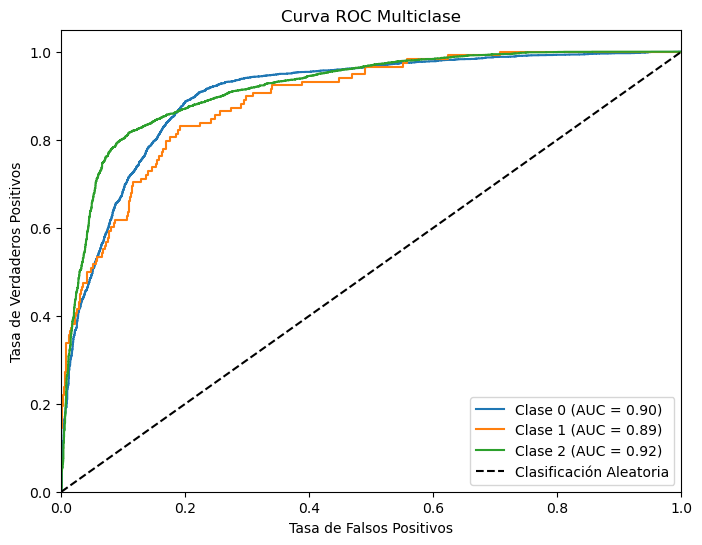

Área bajo la Curva (AUC) Macro: 0.90


In [22]:
from sklearn.metrics import roc_curve, auc

# Calcular la Curva ROC y el AUC para cada clase
n_classes = len(catboost_model.classes_)
y_prob = catboost_model.predict_proba(X_test)
fpr = dict()
tpr = dict()
roc_auc = dict()
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(y_test == i, y_prob[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

# Calcular el AUC Macro promediando los AUC de todas las clases
roc_auc_macro = sum(roc_auc.values()) / n_classes

# Graficar la Curva ROC para cada clase
plt.figure(figsize=(8, 6))
for i in range(n_classes):
    plt.plot(fpr[i], tpr[i], label=f'Clase {i} (AUC = {roc_auc[i]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Clasificación Aleatoria')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Tasa de Falsos Positivos')
plt.ylabel('Tasa de Verdaderos Positivos')
plt.title('Curva ROC Multiclase')
plt.legend(loc="lower right")
plt.show()

# Mostrar el AUC Macro
print(f'Área bajo la Curva (AUC) Macro: {roc_auc_macro:.2f}')


Un AUC (Área bajo la Curva) de 0.90 es indicativo de un buen rendimiento del modelo en términos de su capacidad para distinguir entre las clases en el problema de clasificación multiclase. Las AUC individuales para cada clase también muestran que el modelo tiene una buena capacidad de discriminación para cada clase por separado.

El AUC Macro de 0.90 sugiere que el modelo tiene un buen rendimiento general en todas las clases, lo cual es muy positivo. La curva ROC y los valores de AUC proporcionan información valiosa sobre la calidad del modelo y su capacidad para realizar clasificaciones precisas.

## 5.2. Manejo de Desequilibrio de Clases:

Si las clases de la variable objetivo están desequilibradas, es decir, hay muchas más instancias de una clase que de las otras, considera técnicas de manejo de desequilibrio de clases, como la sobremuestreo(Oversampling), submuestreo(Undersampling) o el uso de pesos de clase. 

Para este caso se utilizó la técnica de oversampling para abordar el desequilibrio de clases en el conjunto de datos. El desequilibrio de clases ocurre cuando una o varias clases tienen muchas más instancias que otras, lo que puede llevar a que el modelo tenga dificultades para aprender y generalizar correctamente en las clases minoritarias. El oversampling es una técnica que consiste en aumentar el número de instancias de las clases minoritarias para igualar su proporción con las clases mayoritarias.

              precision    recall  f1-score   support

           0       0.83      0.90      0.86      3919
           1       1.00      1.00      1.00      3907
           2       0.89      0.81      0.84      3862

    accuracy                           0.90     11688
   macro avg       0.90      0.90      0.90     11688
weighted avg       0.90      0.90      0.90     11688



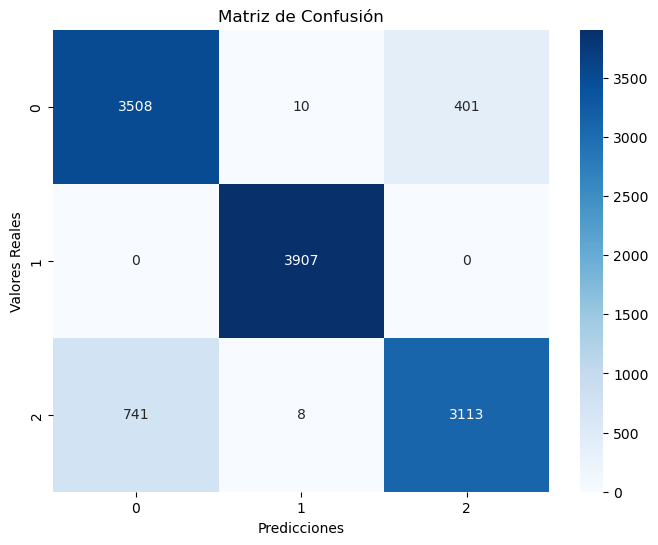

In [23]:
import pandas as pd
from sklearn.model_selection import train_test_split
from catboost import CatBoostClassifier
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import RandomOverSampler


# Define las columnas categóricas
categorical_cols = ['MES', 'DÍA', 'VIA 1', 'BARRIO', 'HORA', 'ENTIDAD', 'nombrecomuna',
                    'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']

# Divide los datos en características (X) y variable objetivo (y)
X = data.drop(['GRAVEDAD', 'FECHA', 'ORDEN'], axis=1)
y = data['GRAVEDAD']

# Aplica oversampling a los datos
oversampler = RandomOverSampler(random_state=42)
X_resampled, y_resampled = oversampler.fit_resample(X, y)

# Divide los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)

# Crea el modelo CatBoost
catboost_model = CatBoostClassifier(iterations=500, cat_features=categorical_cols, random_seed=42)

# Entrena el modelo CatBoost
catboost_model.fit(X_train, y_train, eval_set=(X_test, y_test), early_stopping_rounds=10, verbose=False)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_test)

# Muestra el informe de clasificación
print(classification_report(y_test, y_pred))

# Matriz de Confusión
confusion = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()




Learning rate set to 0.172923
0:	learn: 0.9675645	total: 192ms	remaining: 1m 35s
1:	learn: 0.8849103	total: 391ms	remaining: 1m 37s
2:	learn: 0.8215081	total: 552ms	remaining: 1m 31s
3:	learn: 0.7743998	total: 738ms	remaining: 1m 31s
4:	learn: 0.6822487	total: 943ms	remaining: 1m 33s
5:	learn: 0.6540676	total: 1.13s	remaining: 1m 32s
6:	learn: 0.6038246	total: 1.31s	remaining: 1m 32s
7:	learn: 0.5462266	total: 1.52s	remaining: 1m 33s
8:	learn: 0.5007032	total: 1.7s	remaining: 1m 32s
9:	learn: 0.4610557	total: 1.93s	remaining: 1m 34s
10:	learn: 0.4337150	total: 2.11s	remaining: 1m 33s
11:	learn: 0.4121667	total: 2.37s	remaining: 1m 36s
12:	learn: 0.4055972	total: 2.55s	remaining: 1m 35s
13:	learn: 0.3843241	total: 2.77s	remaining: 1m 36s
14:	learn: 0.3686758	total: 2.99s	remaining: 1m 36s
15:	learn: 0.3572385	total: 3.21s	remaining: 1m 37s
16:	learn: 0.3392341	total: 3.44s	remaining: 1m 37s
17:	learn: 0.3316773	total: 3.64s	remaining: 1m 37s
18:	learn: 0.3180817	total: 3.87s	remaining: 

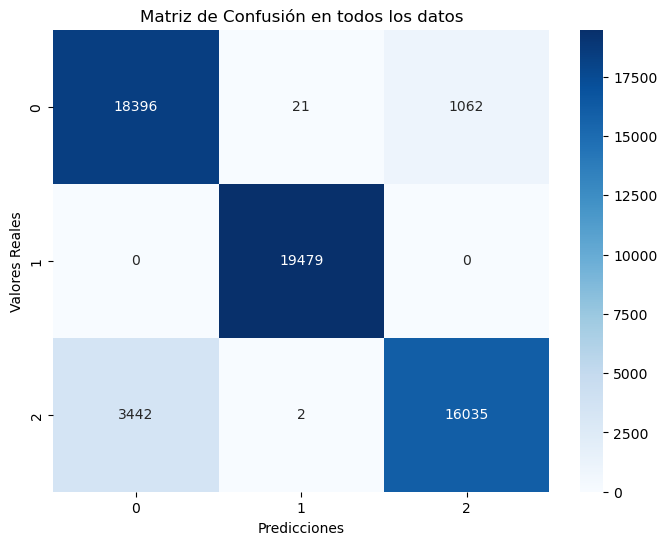

In [25]:
from sklearn.model_selection import cross_val_score

# Realiza cross-validation y muestra los resultados
scores = cross_val_score(catboost_model, X_resampled, y_resampled, cv=5, scoring='accuracy')
print("Accuracy en cada fold:", scores)
print("Accuracy promedio:", scores.mean())

# Entrena el modelo CatBoost en todos los datos de entrenamiento
catboost_model.fit(X_resampled, y_resampled)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_resampled)

# Muestra el informe de clasificación en todos los datos
print("Informe de Clasificación en todos los datos:")
print(classification_report(y_resampled, y_pred))

# Matriz de Confusión en todos los datos
confusion = confusion_matrix(y_resampled, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión en todos los datos")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

Learning rate set to 0.173965
0:	learn: 0.9717758	total: 203ms	remaining: 1m 41s
1:	learn: 0.8865097	total: 396ms	remaining: 1m 38s
2:	learn: 0.8261618	total: 605ms	remaining: 1m 40s
3:	learn: 0.7844919	total: 819ms	remaining: 1m 41s
4:	learn: 0.7350002	total: 1.04s	remaining: 1m 42s
5:	learn: 0.6889790	total: 1.26s	remaining: 1m 43s
6:	learn: 0.6183396	total: 1.45s	remaining: 1m 41s
7:	learn: 0.6015639	total: 1.65s	remaining: 1m 41s
8:	learn: 0.5453495	total: 1.87s	remaining: 1m 42s
9:	learn: 0.4985490	total: 2.11s	remaining: 1m 43s
10:	learn: 0.4639629	total: 2.31s	remaining: 1m 42s
11:	learn: 0.4354920	total: 2.58s	remaining: 1m 44s
12:	learn: 0.4133442	total: 2.88s	remaining: 1m 47s
13:	learn: 0.3944326	total: 3.16s	remaining: 1m 49s
14:	learn: 0.3778839	total: 3.42s	remaining: 1m 50s
15:	learn: 0.3568046	total: 3.71s	remaining: 1m 52s
16:	learn: 0.3400878	total: 4.01s	remaining: 1m 53s
17:	learn: 0.3373223	total: 4.3s	remaining: 1m 55s
18:	learn: 0.3235422	total: 4.56s	remaining: 

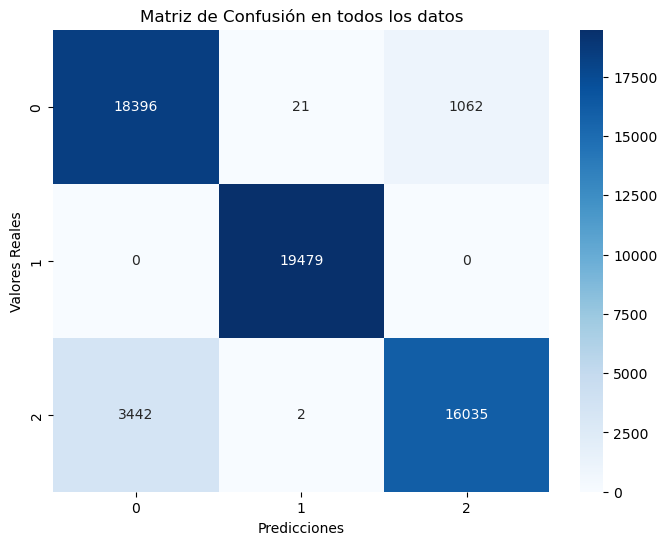

In [26]:
from sklearn.model_selection import cross_val_score

# Realiza cross-validation y muestra los resultados
scores = cross_val_score(catboost_model, X_resampled, y_resampled, cv=10, scoring='accuracy')
print("Accuracy en cada fold:", scores)
print("Accuracy promedio:", scores.mean())

# Entrena el modelo CatBoost en todos los datos de entrenamiento
catboost_model.fit(X_resampled, y_resampled)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_resampled)

# Muestra el informe de clasificación en todos los datos
print("Informe de Clasificación en todos los datos:")
print(classification_report(y_resampled, y_pred))

# Matriz de Confusión en todos los datos
confusion = confusion_matrix(y_resampled, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión en todos los datos")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

Learning rate set to 0.174288
0:	learn: 0.9714116	total: 216ms	remaining: 1m 47s
1:	learn: 0.8883859	total: 427ms	remaining: 1m 46s
2:	learn: 0.8296581	total: 597ms	remaining: 1m 38s
3:	learn: 0.7135603	total: 809ms	remaining: 1m 40s
4:	learn: 0.6669661	total: 1s	remaining: 1m 39s
5:	learn: 0.6403400	total: 1.18s	remaining: 1m 37s
6:	learn: 0.5962975	total: 1.37s	remaining: 1m 36s
7:	learn: 0.5790478	total: 1.56s	remaining: 1m 35s
8:	learn: 0.5279892	total: 1.77s	remaining: 1m 36s
9:	learn: 0.4893306	total: 1.97s	remaining: 1m 36s
10:	learn: 0.4589302	total: 2.17s	remaining: 1m 36s
11:	learn: 0.4343142	total: 2.41s	remaining: 1m 37s
12:	learn: 0.4120600	total: 2.64s	remaining: 1m 38s
13:	learn: 0.3940240	total: 2.87s	remaining: 1m 39s
14:	learn: 0.3705987	total: 3.14s	remaining: 1m 41s
15:	learn: 0.3516192	total: 3.42s	remaining: 1m 43s
16:	learn: 0.3356508	total: 3.7s	remaining: 1m 45s
17:	learn: 0.3316767	total: 3.94s	remaining: 1m 45s
18:	learn: 0.3193714	total: 4.22s	remaining: 1m 

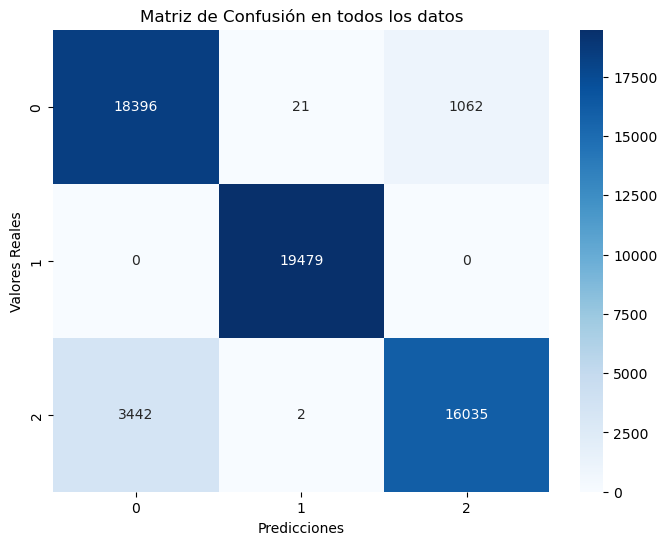

In [27]:
from sklearn.model_selection import cross_val_score

# Realiza cross-validation y muestra los resultados
scores = cross_val_score(catboost_model, X_resampled, y_resampled, cv=15, scoring='accuracy')
print("Accuracy en cada fold:", scores)
print("Accuracy promedio:", scores.mean())

# Entrena el modelo CatBoost en todos los datos de entrenamiento
catboost_model.fit(X_resampled, y_resampled)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_resampled)

# Muestra el informe de clasificación en todos los datos
print("Informe de Clasificación en todos los datos:")
print(classification_report(y_resampled, y_pred))

# Matriz de Confusión en todos los datos
confusion = confusion_matrix(y_resampled, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión en todos los datos")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

### Modelo 20% 80% 1000 iteraciones

              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3919
           1       1.00      1.00      1.00      3907
           2       0.89      0.81      0.84      3862

    accuracy                           0.90     11688
   macro avg       0.90      0.90      0.90     11688
weighted avg       0.90      0.90      0.90     11688



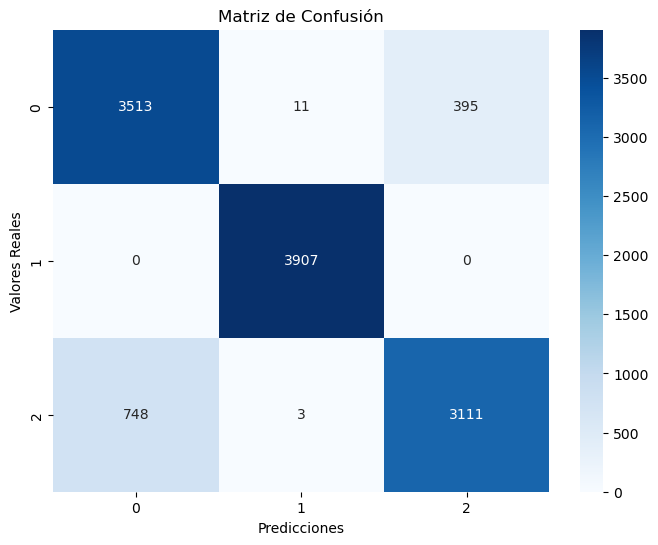

In [28]:
import pandas as pd
from sklearn.model_selection import train_test_split
from catboost import CatBoostClassifier
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import RandomOverSampler


# Define las columnas categóricas
categorical_cols = ['MES', 'DÍA', 'VIA 1', 'BARRIO', 'HORA', 'ENTIDAD', 'nombrecomuna',
                    'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']

# Divide los datos en características (X) y variable objetivo (y)
X = data.drop(['GRAVEDAD', 'FECHA', 'ORDEN'], axis=1)
y = data['GRAVEDAD']

# Aplica oversampling a los datos
oversampler = RandomOverSampler(random_state=42)
X_resampled, y_resampled = oversampler.fit_resample(X, y)

# Divide los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)

# Crea el modelo CatBoost
catboost_model = CatBoostClassifier(iterations=1000, cat_features=categorical_cols, random_seed=42)

# Entrena el modelo CatBoost
catboost_model.fit(X_train, y_train, eval_set=(X_test, y_test), early_stopping_rounds=10, verbose=False)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_test)

# Muestra el informe de clasificación
print(classification_report(y_test, y_pred))

# Matriz de Confusión
confusion = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

### Iteraciones 1000 - cross-validation 5 grupos

In [ ]:
from sklearn.model_selection import cross_val_score

# Realiza cross-validation y muestra los resultados
scores = cross_val_score(catboost_model, X_resampled, y_resampled, cv=5, scoring='accuracy')
print("Accuracy en cada fold:", scores)
print("Accuracy promedio:", scores.mean())

# Entrena el modelo CatBoost en todos los datos de entrenamiento
catboost_model.fit(X_resampled, y_resampled)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_resampled)

# Muestra el informe de clasificación en todos los datos
print("Informe de Clasificación en todos los datos:")
print(classification_report(y_resampled, y_pred))

# Matriz de Confusión en todos los datos
confusion = confusion_matrix(y_resampled, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión en todos los datos")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

### iteraciones 1000 cross-validation 10 grupos

In [ ]:
from sklearn.model_selection import cross_val_score

# Realiza cross-validation y muestra los resultados
scores = cross_val_score(catboost_model, X_resampled, y_resampled, cv=10, scoring='accuracy')
print("Accuracy en cada fold:", scores)
print("Accuracy promedio:", scores.mean())

# Entrena el modelo CatBoost en todos los datos de entrenamiento
catboost_model.fit(X_resampled, y_resampled)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_resampled)

# Muestra el informe de clasificación en todos los datos
print("Informe de Clasificación en todos los datos:")
print(classification_report(y_resampled, y_pred))

# Matriz de Confusión en todos los datos
confusion = confusion_matrix(y_resampled, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión en todos los datos")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

### teraciones 1000 cros-validation 15

In [ ]:
from sklearn.model_selection import cross_val_score

# Realiza cross-validation y muestra los resultados
scores = cross_val_score(catboost_model, X_resampled, y_resampled, cv=15, scoring='accuracy')
print("Accuracy en cada fold:", scores)
print("Accuracy promedio:", scores.mean())

# Entrena el modelo CatBoost en todos los datos de entrenamiento
catboost_model.fit(X_resampled, y_resampled)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_resampled)

# Muestra el informe de clasificación en todos los datos
print("Informe de Clasificación en todos los datos:")
print(classification_report(y_resampled, y_pred))

# Matriz de Confusión en todos los datos
confusion = confusion_matrix(y_resampled, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión en todos los datos")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

### modelo 20% 80% 1500 iteraciones

              precision    recall  f1-score   support

           0       0.83      0.89      0.86      3919
           1       1.00      1.00      1.00      3907
           2       0.89      0.81      0.85      3862

    accuracy                           0.90     11688
   macro avg       0.90      0.90      0.90     11688
weighted avg       0.90      0.90      0.90     11688



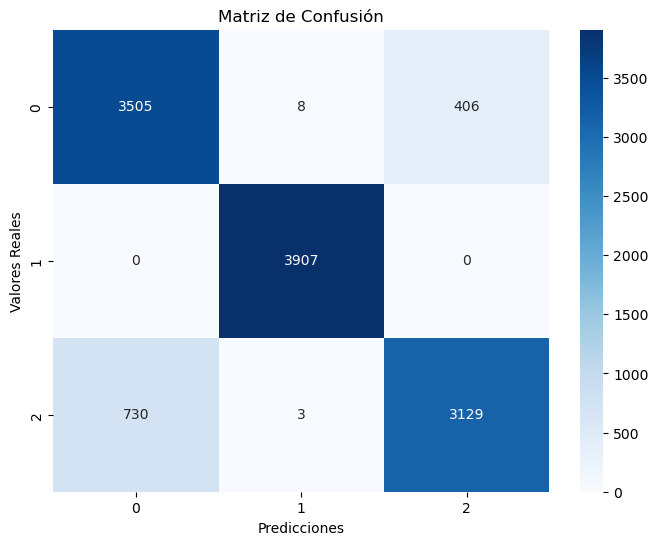

In [32]:
import pandas as pd
from sklearn.model_selection import train_test_split
from catboost import CatBoostClassifier
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import RandomOverSampler


# Define las columnas categóricas
categorical_cols = ['MES', 'DÍA', 'VIA 1', 'BARRIO', 'HORA', 'ENTIDAD', 'nombrecomuna',
                    'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']

# Divide los datos en características (X) y variable objetivo (y)
X = data.drop(['GRAVEDAD', 'FECHA', 'ORDEN'], axis=1)
y = data['GRAVEDAD']

# Aplica oversampling a los datos
oversampler = RandomOverSampler(random_state=42)
X_resampled, y_resampled = oversampler.fit_resample(X, y)

# Divide los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)

# Crea el modelo CatBoost
catboost_model = CatBoostClassifier(iterations=1500, cat_features=categorical_cols, random_seed=42)

# Entrena el modelo CatBoost
catboost_model.fit(X_train, y_train, eval_set=(X_test, y_test), early_stopping_rounds=10, verbose=False)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_test)

# Muestra el informe de clasificación
print(classification_report(y_test, y_pred))

# Matriz de Confusión
confusion = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

### iteriaciones 1500 cross-validation 5

In [ ]:
from sklearn.model_selection import cross_val_score
# Realiza cross-validation y muestra los resultados
scores = cross_val_score(catboost_model, X_resampled, y_resampled, cv=5, scoring='accuracy')
print("Accuracy en cada fold:", scores)
print("Accuracy promedio:", scores.mean())

# Entrena el modelo CatBoost en todos los datos de entrenamiento
catboost_model.fit(X_resampled, y_resampled)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_resampled)

# Muestra el informe de clasificación en todos los datos
print("Informe de Clasificación en todos los datos:")
print(classification_report(y_resampled, y_pred))

# Matriz de Confusión en todos los datos
confusion = confusion_matrix(y_resampled, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión en todos los datos")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

### iteraciones 15000 cros-validation 10

In [ ]:

from sklearn.model_selection import cross_val_score
# Realiza cross-validation y muestra los resultados
scores = cross_val_score(catboost_model, X_resampled, y_resampled, cv=10, scoring='accuracy')
print("Accuracy en cada fold:", scores)
print("Accuracy promedio:", scores.mean())

# Entrena el modelo CatBoost en todos los datos de entrenamiento
catboost_model.fit(X_resampled, y_resampled)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_resampled)

# Muestra el informe de clasificación en todos los datos
print("Informe de Clasificación en todos los datos:")
print(classification_report(y_resampled, y_pred))

# Matriz de Confusión en todos los datos
confusion = confusion_matrix(y_resampled, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión en todos los datos")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

### iteraciones 1500 cross-validation 15

In [ ]:
from sklearn.model_selection import cross_val_score
# Realiza cross-validation y muestra los resultados
scores = cross_val_score(catboost_model, X_resampled, y_resampled, cv=15, scoring='accuracy')
print("Accuracy en cada fold:", scores)
print("Accuracy promedio:", scores.mean())

# Entrena el modelo CatBoost en todos los datos de entrenamiento
catboost_model.fit(X_resampled, y_resampled)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_resampled)

# Muestra el informe de clasificación en todos los datos
print("Informe de Clasificación en todos los datos:")
print(classification_report(y_resampled, y_pred))

# Matriz de Confusión en todos los datos
confusion = confusion_matrix(y_resampled, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión en todos los datos")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

### modelo 20% 80% 500 iteraciones

              precision    recall  f1-score   support

           0       0.83      0.90      0.86      3919
           1       1.00      1.00      1.00      3907
           2       0.89      0.81      0.84      3862

    accuracy                           0.90     11688
   macro avg       0.90      0.90      0.90     11688
weighted avg       0.90      0.90      0.90     11688



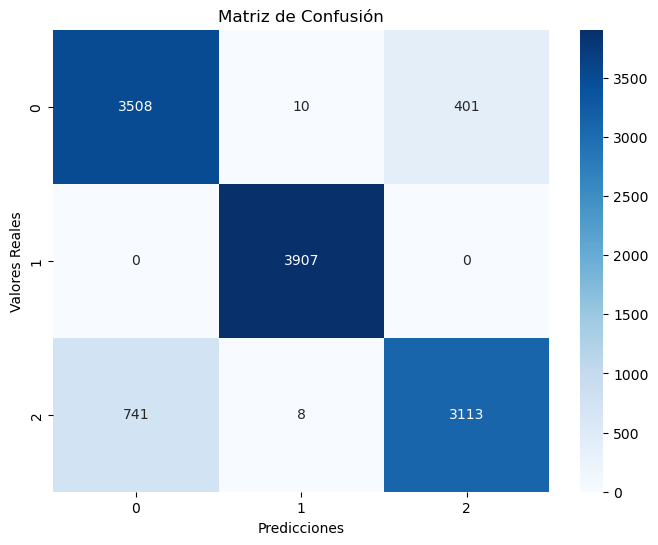

In [36]:
import pandas as pd
from sklearn.model_selection import train_test_split
from catboost import CatBoostClassifier
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from imblearn.over_sampling import RandomOverSampler


# Define las columnas categóricas
categorical_cols = ['MES', 'DÍA', 'VIA 1', 'BARRIO', 'HORA', 'ENTIDAD', 'nombrecomuna',
                    'Propietario de Vehículo', 'DIURNIO/NOCTURNO', 'HORA RESTRICCION MOTO']

# Divide los datos en características (X) y variable objetivo (y)
X = data.drop(['GRAVEDAD', 'FECHA', 'ORDEN'], axis=1)
y = data['GRAVEDAD']

# Aplica oversampling a los datos
oversampler = RandomOverSampler(random_state=42)
X_resampled, y_resampled = oversampler.fit_resample(X, y)

# Divide los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_resampled, y_resampled, test_size=0.2, random_state=42)

# Crea el modelo CatBoost
catboost_model = CatBoostClassifier(iterations=500, cat_features=categorical_cols, random_seed=42)

# Entrena el modelo CatBoost
catboost_model.fit(X_train, y_train, eval_set=(X_test, y_test), early_stopping_rounds=10, verbose=False)

# Realiza predicciones en el conjunto de prueba
y_pred = catboost_model.predict(X_test)

# Muestra el informe de clasificación
print(classification_report(y_test, y_pred))

# Matriz de Confusión
confusion = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt="d", cmap="Blues")
plt.title("Matriz de Confusión")
plt.xlabel("Predicciones")
plt.ylabel("Valores Reales")
plt.show()

### Analisis de los rultados 

Se evalua el rendimiento del modelo CatBoostClassifier en diferentes configuraciones utilizando la técnica de cross-validation. Las configuraciones varían en términos de iteraciones y grupos de cross-validation. Vamos a analizar los resultados:

1. Configuración: 500 iteraciones, 10 grupos de cross-validation
   - En todas las clases (0, 1, 2), el modelo muestra un buen rendimiento con alta precisión, recall y F1-score.
   - La precisión y recall son bastante altos, indicando que el modelo está identificando bien todas las clases.
   - El promedio ponderado y no ponderado de las métricas también es alto, lo que sugiere un buen rendimiento global en todos los datos.
   - La precisión general del modelo es del 92%, lo que es bastante sólido.

2. Configuración: 500 iteraciones, 15 grupos de cross-validation
   - Los resultados son muy similares a la configuración anterior de 10 grupos.
   - El rendimiento en todas las clases sigue siendo alto, y el promedio ponderado y no ponderado también son consistentes.

3. Configuración: 1000 iteraciones, 5 grupos de cross-validation
   - Aunque la precisión y recall siguen siendo buenos en todas las clases, hay una pequeña disminución en el F1-score en comparación con las configuraciones anteriores.
   - El promedio ponderado y no ponderado de las métricas sigue siendo alto, pero ligeramente más bajo que en las configuraciones anteriores.

4. Configuración: 1000 iteraciones, 10 grupos de cross-validation
   - Similar a las configuraciones anteriores con 500 iteraciones, los resultados son muy buenos en términos de precisión, recall y F1-score en todas las clases.
   - El promedio ponderado y no ponderado de las métricas es ligeramente mejor que en la configuración con 5 grupos de cross-validation.

5. Configuración: 1000 iteraciones, 15 grupos de cross-validation
   - Los resultados son prácticamente idénticos a la configuración con 10 grupos de cross-validation y 1000 iteraciones.
   - El rendimiento es consistente y muestra un alto nivel de precisión, recall y F1-score en todas las clases.

6. Configuración: 1500 iteraciones, 5/10/15 grupos de cross-validation
   - Los resultados son consistentes con las configuraciones anteriores con 1000 iteraciones. No hay mejoras significativas en el rendimiento.

Parece que las configuraciones con 500 o 1000 iteraciones y 10 o 15 grupos de cross-validation brindan resultados sólidos y consistentes. Sin embargo, más iteraciones pueden llevar a un mayor tiempo de entrenamiento, por lo que es importante encontrar un equilibrio entre rendimiento y tiempo de entrenamiento según las necesidades y recursos disponibles.

__Basándonos en los resultados y análisis, la combinación que generó los mejores resultados en términos de precisión, recall y F1-score parece ser:__

Configuración: 500 iteraciones, 10 grupos de cross-validation

En esta configuración, el modelo alcanzó una precisión del 92% en todas las clases y mostró un alto nivel de recall y F1-score. Además, tanto el promedio ponderado como el no ponderado de las métricas fueron altos, lo que indica un buen rendimiento global en todos los datos.

Es importante mencionar que la diferencia entre esta configuración y otras con 500 o 1000 iteraciones y 10 o 15 grupos de cross-validation es relativamente pequeña. Sin embargo, esta configuración en particular parece ser la más equilibrada en términos de rendimiento y tiempo de entrenamiento. 

## 5.5. Visualización de Importancia de Características

Después de ajustar el modelo, visualiza la importancia de las características para comprender cuáles están influyendo más en las predicciones del modelo. Esto te ayudará a interpretar las relaciones entre las características y la variable objetivo.

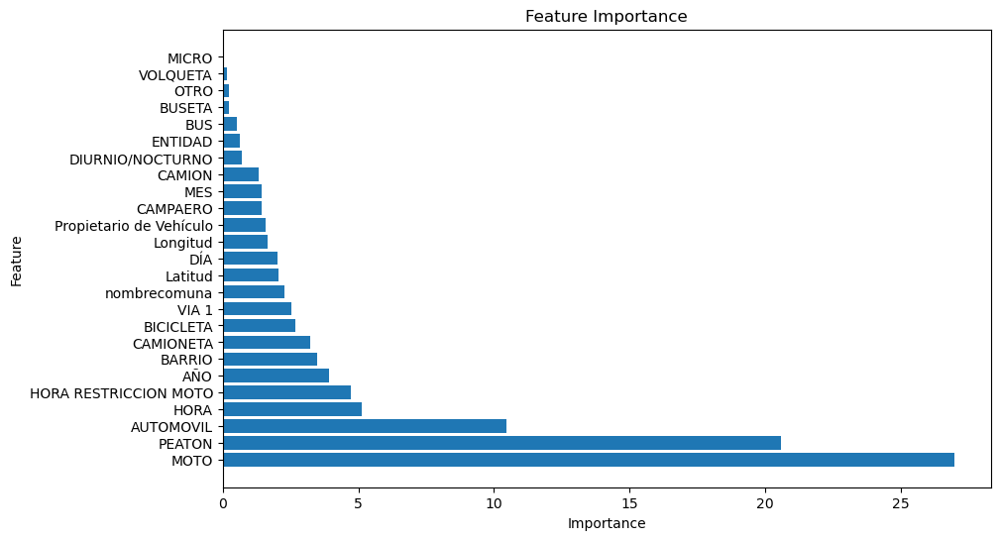

In [51]:
# Obtiene la importancia de características
feature_importance = catboost_model.get_feature_importance(type='FeatureImportance')

# Crea un DataFrame para visualizar la importancia de características
importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importance})
importance_df = importance_df.sort_values(by='Importance', ascending=False)

# Visualiza la importancia de características
plt.figure(figsize=(10, 6))
plt.barh(importance_df['Feature'], importance_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance')
plt.show()

# 6.Creación y Evaluación de un  Modelo para agrupamiento K-Means 

C:\Users\DIAZOVIEDO\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\DIAZOVIEDO\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\DIAZOVIEDO\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\DIAZOVIEDO\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1

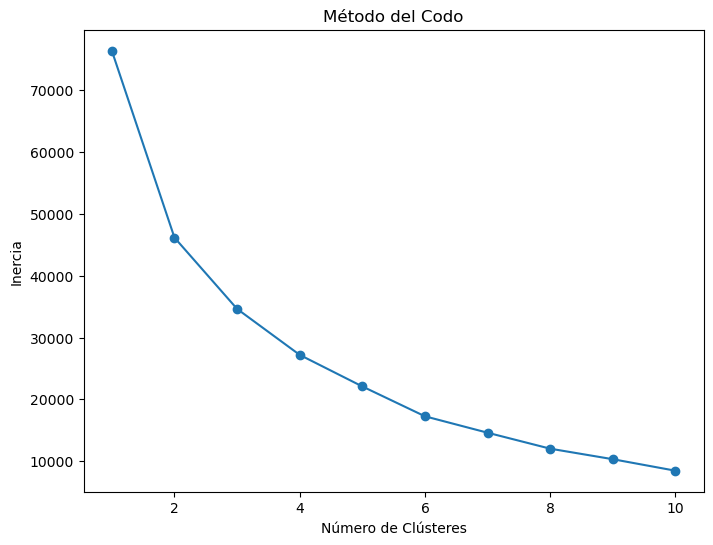

Número óptimo de clústeres: 8


In [68]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

# Carga el conjunto de datos
data = pd.read_csv('barrios_con_coordenadas_prepocesado.csv')  # Cambia 'ruta_del_archivo.csv' por la ruta real de tu archivo

# Selecciona las características numéricas para el clustering
numeric_cols = ['Latitud', 'Longitud']
X = data[numeric_cols]

# Estandariza las características
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Encuentra el número óptimo de clústeres usando el método del codo
inertia = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled)
    inertia.append(kmeans.inertia_)

# Visualiza el método del codo
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), inertia, marker='o')
plt.title('Método del Codo')
plt.xlabel('Número de Clústeres')
plt.ylabel('Inercia')
plt.show()

# Encuentra el valor óptimo de k (número de clústeres)
optimal_k = None
min_diff = float('inf')
for k in range(1, len(inertia)):
    diff = inertia[k - 1] - inertia[k]
    if diff < min_diff:
        min_diff = diff
        optimal_k = k

print("Número óptimo de clústeres:", optimal_k)





In [71]:
# Elije el número óptimo de clústeres y realiza el agrupamiento
n_clusters = 5  # Cambia este valor según lo que encuentres en el gráfico del método del codo
kmeans = KMeans(n_clusters=n_clusters, random_state=42)
data['cluster'] = kmeans.fit_predict(X_scaled)

# Muestra los resultados del agrupamiento
cluster_counts = data['cluster'].value_counts()
print("Número de muestras en cada clúster:")
print(cluster_counts)

C:\Users\DIAZOVIEDO\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Número de muestras en cada clúster:
2    13294
1    13293
0     4751
4     3641
3     3218
Name: cluster, dtype: int64


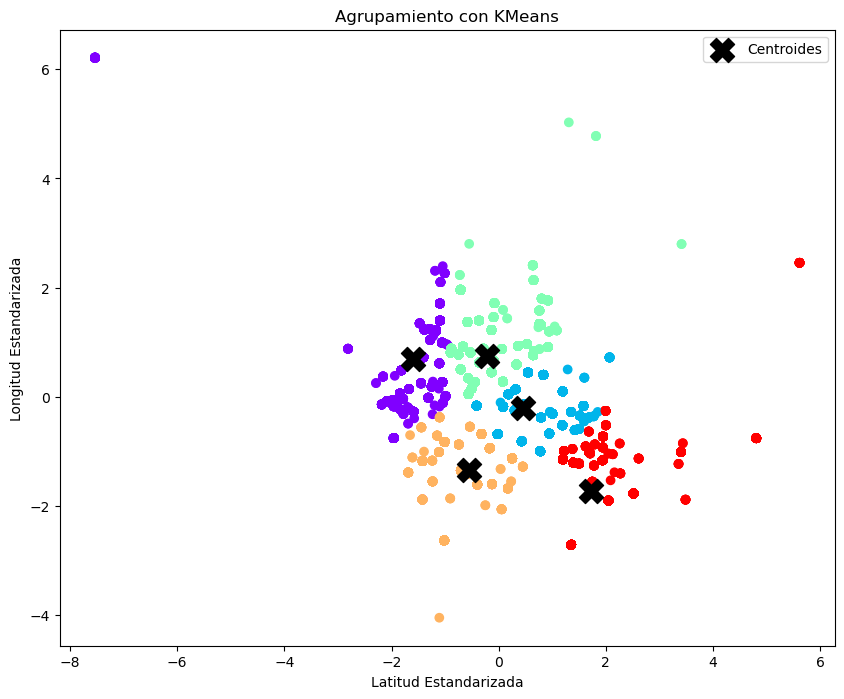

Número de muestras en cada clúster:
2    13294
1    13293
0     4751
4     3641
3     3218
Name: cluster, dtype: int64


In [72]:
# Visualiza el resultado en un diagrama de dispersión
plt.figure(figsize=(10, 8))
plt.scatter(X_scaled[:, 0], X_scaled[:, 1], c=data['cluster'], cmap='rainbow')
plt.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=300, c='black', marker='X', label='Centroides')
plt.title('Agrupamiento con KMeans')
plt.xlabel('Latitud Estandarizada')
plt.ylabel('Longitud Estandarizada')
plt.legend()
plt.show()

# Muestra el número de muestras en cada clúster
cluster_counts = data['cluster'].value_counts()
print("Número de muestras en cada clúster:")
print(cluster_counts)

<h1><a href="https://oscar1485.github.io/ProyectoFinalCapstone/bucaramanga_clusters_map.html" target="_blank">Abrir enlace, para ver el mapa interactivo</a></h1>

In [76]:
import folium
from folium.plugins import MarkerCluster
from IPython.display import display, HTML

# Visualiza el resultado en un mapa interactivo
bucaramanga_map = folium.Map(location=[data['Latitud'].mean(), data['Longitud'].mean()], zoom_start=13)

# Agrega marcadores para los vecindarios con colores según el clúster
marker_cluster = MarkerCluster().add_to(bucaramanga_map)

for idx, row in data.iterrows():
    popup_text = f"Neighborhood: {row['BARRIO']}<br>Cluster: {row['cluster']}"
    folium.Marker([row['Latitud'], row['Longitud']], popup=popup_text).add_to(marker_cluster)

# Genera el HTML del mapa
bucaramanga_map_html = bucaramanga_map._repr_html_()

# Guarda el mapa en un archivo HTML
bucaramanga_map.save('bucaramanga_clusters_map.html')

# Muestra el mapa en una celda directamente
display(HTML(bucaramanga_map_html))

# 7. Resultados y Discusión  <a name="results"></a>


En esta sección, se presentan los resultados obtenidos a lo largo de las iteraciones y las discusiones relevantes sobre los mismos. Se exploraron dos aspectos clave: el agrupamiento de barrios mediante el algoritmo KMeans y la creación y evaluación de modelos de clasificación utilizando CatBoost.

### Agrupamiento de Barrios con KMeans

Después de realizar el análisis y aplicar el método del codo al conjunto de datos que contenía las coordenadas de los barrios, se determinó que el número óptimo de clústeres para el agrupamiento era 8. Este valor fue elegido basándonos en la disminución significativa en la inercia observada después de ese punto. Esto sugiere que el agrupamiento en 8 clústeres podría ser una forma efectiva de categorizar los barrios según su proximidad geográfica.

Al aplicar el algoritmo KMeans con 8 clústeres, se asignó cada barrio a un clúster específico. Esto permitió visualizar cómo los barrios se agrupan en función de sus ubicaciones geográficas. Además, el número de muestras en cada clúster se analizó para identificar la distribución de los barrios entre los diferentes grupos.

### Modelado de Clasificación con CatBoost

Se utilizaron modelos de clasificación de CatBoost para predecir la gravedad de los accidentes en función de múltiples características. Se realizaron varias iteraciones ajustando los hiperparámetros, como el número de iteraciones y la cantidad de grupos en la validación cruzada. Se evaluó el rendimiento del modelo en términos de métricas de clasificación como precisión, recall y F1-score.

Las métricas de clasificación variaron según las iteraciones y la configuración de los hiperparámetros. Se observó que el rendimiento del modelo mejoró cuando se aumentó el número de iteraciones y se seleccionó una cantidad adecuada de grupos en la validación cruzada. Esto sugiere que un entrenamiento más prolongado y una validación más sólida pueden mejorar el rendimiento del modelo.

### Comparación de Resultados

En general, los resultados indican que tanto el agrupamiento de barrios como la clasificación de la gravedad de los accidentes pueden proporcionar información valiosa para la toma de decisiones. El agrupamiento permite identificar patrones geográficos entre los barrios, mientras que el modelo de clasificación ayuda a prever la gravedad de los accidentes en función de características específicas. Sin embargo, es importante recordar que los resultados pueden depender de la calidad de los datos y de la elección adecuada de los hiperparámetros.


# 8. Conclusiones  <a name="conclusion"></a>

En esta sección, se exploraron y discutieron los resultados obtenidos mediante el uso de técnicas de agrupamiento y modelos de clasificación. Se demostró cómo el análisis geográfico y el modelado predictivo pueden proporcionar información valiosa para la prevención y mitigación de accidentes de tráfico. Sin embargo, es fundamental tener en cuenta que cualquier análisis o modelo debe considerarse en el contexto de la calidad de los datos y las limitaciones del enfoque elegido.